In [1]:
import numpy as np
import tensorflow as tf

import os
# np.random.seed(1337)  # for reproducibility
# tf.random.set_seed(1337)
# os.environ['TF_DETERMINISTIC_OPS'] = '1'
# os.environ['TF_CUDNN_DETERMINISTIC '] = '1'


# os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
# os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [2]:
base_coin_str = 'BTC'
base_coin_fullname_str = 'bitcoin'

In [3]:
from data.utils import load_data
from data.scaling import normalize

filtro_tipos_eventos_permitidos = ['listing', 'launch', 'fork']
query_str = 'title.isna()'
for filtro in filtro_tipos_eventos_permitidos:
    query_str += f' or title.str.lower().str.contains("{filtro}")'
    # df = df.query(f'event_title.isna() or event_title.str.lower().str.contains("{filtro}")')
print(query_str)

title.isna() or title.str.lower().str.contains("listing") or title.str.lower().str.contains("launch") or title.str.lower().str.contains("fork")


In [4]:
df = load_data(base_coin_str, base_coin_fullname_str, event_days_left_lookback=7, storage_folder='../data', events_query=query_str)
prices, _ = normalize(df.loc[:, 'price'].to_numpy())
variation = df.loc[:, 'price (%)'].to_numpy()
# variation = df.loc[:, 'price'].pct_change().fillna(0).to_numpy()
volume, _ = normalize(df['Volume'].to_numpy())
volume_variation = df['Volume'].pct_change().fillna(0).to_numpy()
tweet, _ = normalize(df.loc[:, 'tweet_volume'].to_numpy())
tweet_variation = df.loc[:, 'tweet_volume'].pct_change().fillna(0).to_numpy()
google_trends, _ = normalize(df.loc[:, 'trend'].to_numpy())
google_trends_variation = df.loc[:, 'trend'].pct_change().fillna(0).to_numpy()

In [5]:
STOCHk_7, _ = normalize(df['STOCHk_7'].fillna(50.0).to_numpy())
STOCHk_14, _ = normalize(df['STOCHk_14'].fillna(50.0).to_numpy())
STOCHk_28, _ = normalize(df['STOCHk_28'].fillna(50.0).to_numpy())
STOCHk_56, _ = normalize(df['STOCHk_56'].fillna(50.0).to_numpy())

RSI_7, _ = normalize(df['RSI_7'].fillna(50.0).to_numpy())
RSI_14, _ = normalize(df['RSI_14'].fillna(50.0).to_numpy())
RSI_28, _ = normalize(df['RSI_28'].fillna(50.0).to_numpy())
RSI_56, _ = normalize(df['RSI_56'].fillna(50.0).to_numpy())

STOCHRSI_7, _ = normalize(df['STOCHRSI_7'].fillna(50.0).to_numpy())
STOCHRSI_14, _ = normalize(df['STOCHRSI_14'].fillna(50.0).to_numpy())
STOCHRSI_28, _ = normalize(df['STOCHRSI_28'].fillna(50.0).to_numpy())
STOCHRSI_56, _ = normalize(df['STOCHRSI_56'].fillna(50.0).to_numpy())

In [6]:
from typing import Tuple
# look_behind: passos (dias) anteriores usados para prever o proximo.
N = 30
foward_days = 1  # quantos dias prever

def to_keras_format(features: list, target) -> Tuple[np.array, np.array]:
    n_samples = len(target) - N - (foward_days-1)
    # matriz de dimensao: [n_samples, N, n_features];
    features_set = np.empty((n_samples, N, len(features)))  # type: np.ndarray
    labels = [None]*n_samples
    for i in range(n_samples):
        for j in range(N):
            for ft_idx in range(len(features)):
                feature = features[ft_idx]
                features_set[i, j, ft_idx] = feature[i+j]

        labels[i] = target[N+i-1: N+i+foward_days]
    labels = np.array(labels)

    return features_set, labels

In [7]:
from keras.models import Model
from keras.layers import Input, LSTM, Dropout, Dense

def build_model(train_X, train_y) -> Model:
    inputs = Input(shape=train_X.shape[1:])
    lstm = LSTM(units=750, return_sequences=False, input_shape=train_X.shape[1:])(inputs)
    lstm = Dropout(0.1)(lstm)
    x = Dense(units=175, activation='linear')(lstm)
    x = Dropout(0.1)(x)
    x = Dense(units=75, activation='linear')(x)
    x = Dropout(0.1)(x)
    x = Dense(units=foward_days)(x)
    return Model(inputs=inputs, outputs=x)

In [8]:
from matplotlib import pyplot as plt
# vizualizando estatisticas do modelo em si e seu treino
def plot_train_history(modelo: Model, plot_above_or_below_zero_accuracy: bool, plotValidation = True, figsize=(25,10)):
    plt.rcParams['figure.figsize'] = figsize
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2)

    ax1.plot(modelo.history.history['loss'])
    if plotValidation: ax1.plot(modelo.history.history['val_loss'])
    ax1.title.set_text('model loss')
    ax1.set_ylabel('loss')
    ax1.set_xlabel('epoch')
    ax1.legend(['train', 'test'], loc='upper left')

    ax2.plot(modelo.history.history['mean_squared_error'])
    if plotValidation: ax2.plot(modelo.history.history['val_mean_squared_error'])
    ax2.title.set_text('model meanSquaredError')
    ax2.set_ylabel('mse')
    ax2.set_xlabel('epoch')
    ax2.legend(['train', 'test'], loc='upper left')

    ax3.plot(modelo.history.history['movement_accuracy'])
    if plotValidation: ax3.plot(modelo.history.history['val_movement_accuracy'])
    ax3.title.set_text('model movement direction accuracy')
    ax3.set_ylabel('accuracy')
    ax3.set_xlabel('epoch')
    ax3.legend(['train', 'test'], loc='upper left')

    # plote esse apenas se seu dado target for de variação (não faz sentido para dado bruto)
    if plot_above_or_below_zero_accuracy:
        ax4.plot(modelo.history.history['above_or_below_zero_accuracy'])
        if plotValidation: ax4.plot(modelo.history.history['val_above_or_below_zero_accuracy'])
        ax4.title.set_text('price up or down accuracy *')
        ax4.set_ylabel('accuracy')
        ax4.set_xlabel('epoch')
        ax4.legend(['train', 'test'], loc='upper left')
    
    plt.tight_layout()
    plt.show()

In [9]:
# tf.keras.backend.clear_session() #limpa modelos e dados anteriores, para evitar vazamento de memoria
from metrics.custom import above_or_below_zero_accuracy, movement_accuracy
from metrics.custom import mean_squared_error, mean_absolute_error, cosine_similarity as custom_cosine_similarity, mean_absolute_percentage_error
from metrics.custom import RootMeanSquaredError

from sklearn.model_selection import KFold, RepeatedKFold
from shutil import rmtree

def get_model_name(k, n_repeat = None):
    if n_repeat:
        return 'model_'+str(k)+'_'+str(n_repeat)+'.h5'
    return 'model_'+str(k)+'.h5'

def build_and_run_and_show(features, target, loss_function, shuffle_mask=None, epochs=400, batch_size=128) -> Model:
    save_dir = './tmp_altcoins/saved_models/'
    if os.path.exists(save_dir):
        rmtree(save_dir)

    features_set, labels = to_keras_format(features, target)

    if shuffle_mask is None:
        shuffle_mask = np.arange(len(features_set))
        np.random.shuffle(shuffle_mask)

    unshuffle_mask = np.zeros(len(shuffle_mask), dtype=int)
    for i in range(len(shuffle_mask)):
        unshuffle_mask[shuffle_mask[i]] = i

    features_set, labels = features_set[shuffle_mask], labels[shuffle_mask]

    
    TEST_MSE = []
    TEST_MOV_ACCURACY = []
    TEST_UPDOWN_ACCURACY = []
    # kf = KFold(n_splits = 5)
    n_repeats = 2
    kf = RepeatedKFold(n_splits = 5, n_repeats = n_repeats, random_state=1337) # random_state fixo para manter reproducibilidade entre chamadas dessa função

    fold_num = 1
    repeat_num = 1
    for train_index, test_index  in kf.split(features_set, labels):
        tf.keras.backend.clear_session()

        train_X, train_y = features_set[train_index], labels[train_index]
        test_X, test_y = features_set[test_index], labels[test_index]

        model = build_model(train_X, train_y)
        opt = tf.keras.optimizers.Adam(learning_rate=0.001, amsgrad=True)
        model.compile(optimizer=opt, loss=loss_function, metrics=[mean_squared_error, movement_accuracy, above_or_below_zero_accuracy])# 'cosine_similarity', 'mean_squared_error'

        # CREATE CALLBACKS
        best_mse_checkpoint = tf.keras.callbacks.ModelCheckpoint(save_dir+'mse/'+get_model_name(fold_num, repeat_num),#+'_{epoch:03d}-{val_mean_squared_error:.5f}', 
                                monitor='val_mean_squared_error', verbose=0, save_best_only=True, mode='min')
        best_movAcc_checkpoint = tf.keras.callbacks.ModelCheckpoint(save_dir+'mov_accuracy/'+get_model_name(fold_num, repeat_num),#+'_{epoch:03d}-{val_movement_accuracy:.5f}', 
                                monitor='val_movement_accuracy', verbose=0, save_best_only=True, mode='max')
        best_above_below_zero_checkpoint = tf.keras.callbacks.ModelCheckpoint(save_dir+'above_or_below_zero_accuracy/'+get_model_name(fold_num, repeat_num),#+'_{epoch:03d}-{val_movement_accuracy:.5f}', 
                                monitor='val_above_or_below_zero_accuracy', verbose=0, save_best_only=True, mode='max')
        checkpoints = [best_mse_checkpoint, best_movAcc_checkpoint, best_above_below_zero_checkpoint]

        print(f'treinando fold {fold_num}, repetição {repeat_num} (400 epochs dá 2min +-)')
        model.fit(train_X, train_y, validation_data=(test_X, test_y), epochs=epochs, batch_size=batch_size, callbacks=checkpoints, verbose=0)
        

        # PLOT HISTORY
        plot_train_history(model, plot_above_or_below_zero_accuracy=True, figsize=(25,8))

        # LOAD BEST MODEL (for specific metric) to evaluate the performance of the model
        model.load_weights(save_dir+"mse/"+get_model_name(fold_num, repeat_num))
        results = model.evaluate(x=test_X, y=test_y, batch_size=1)
        results = dict(zip(model.metrics_names, results))
        TEST_MSE.append(results['mean_squared_error'])
        
        model.load_weights(save_dir+"mov_accuracy/"+get_model_name(fold_num, repeat_num))
        results = model.evaluate(x=test_X, y=test_y, batch_size=1)
        results = dict(zip(model.metrics_names, results))
        TEST_MOV_ACCURACY.append(results['movement_accuracy'])

        model.load_weights(save_dir+"above_or_below_zero_accuracy/"+get_model_name(fold_num, repeat_num))
        results = model.evaluate(x=test_X, y=test_y, batch_size=1)
        results = dict(zip(model.metrics_names, results))
        TEST_UPDOWN_ACCURACY.append(results['above_or_below_zero_accuracy'])

        if repeat_num % n_repeats == 0:
            fold_num +=1
            repeat_num = 1
        else:    
            repeat_num += 1        

        rmtree(save_dir)
        tf.keras.backend.clear_session()

    print('\nResults:\n')
    print(f'MeanSquaredError: {TEST_MSE}')
    print(f'MovementDiretionAccuracy: {TEST_MOV_ACCURACY}')
    print(f'AboveOrBellowAccuracy: {TEST_UPDOWN_ACCURACY}\n')
    print(f'MeanSquaredError mean: {np.mean(TEST_MSE)}')
    print(f'MovementDiretionAccuracy mean: {np.mean(TEST_MOV_ACCURACY)}')
    print(f'AboveOrBellowAccuracy mean: {np.mean(TEST_UPDOWN_ACCURACY)}\n')
    print(f'MeanSquaredError std: {np.std(TEST_MSE)}')
    print(f'MovementDiretionAccuracy std: {np.std(TEST_MOV_ACCURACY)}')
    print(f'AboveOrBellowAccuracy std: {np.std(TEST_UPDOWN_ACCURACY)}')

    return

# Agora vamo ver Indicadores tecnicos nas outras features

## Ethereum

In [10]:
base_coin_str = 'ETH'
base_coin_fullname_str = 'ethereum'

df = load_data(base_coin_str, base_coin_fullname_str, event_days_left_lookback=7, storage_folder='../data', events_query=query_str)
variation = df.loc[:, 'price (%)'].to_numpy()
volume_variation = df['Volume'].pct_change().fillna(0).to_numpy()

features_set, _ = to_keras_format([variation], variation)
shuffle_mask = np.arange(len(features_set))
np.random.shuffle(shuffle_mask)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


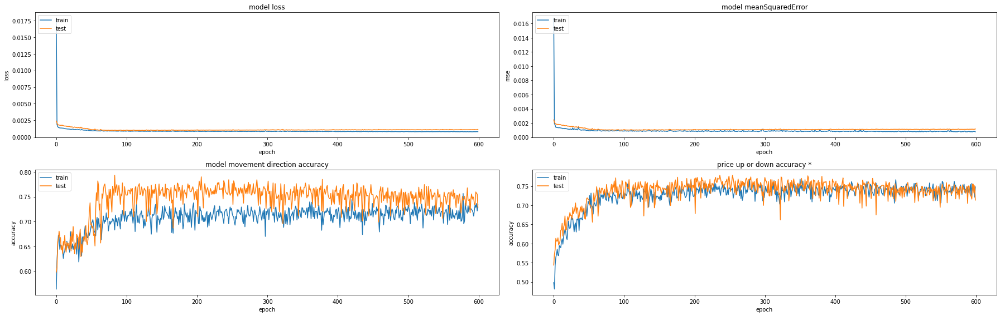

356/356 [==============================] - 2s 5ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7669 - above_or_below_zero_accuracy: 0.7781    
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


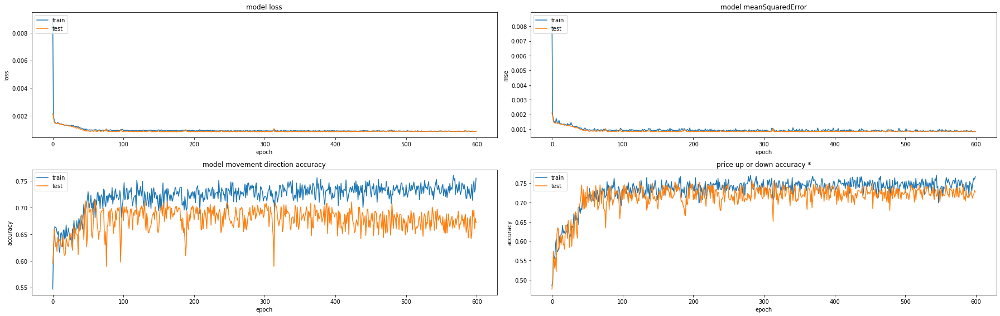

356/356 [==============================] - 2s 5ms/step - loss: 8.2365e-04 - mean_squared_error: 8.2365e-04 - movement_accuracy: 0.7051 - above_or_below_zero_accuracy: 0.7584
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


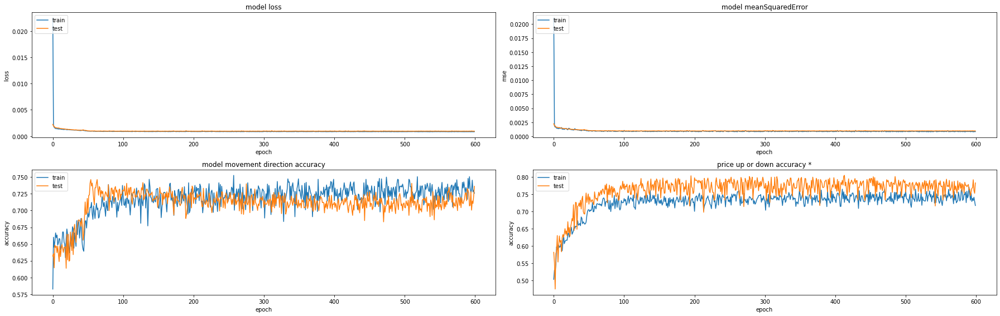

356/356 [==============================] - 2s 6ms/step - loss: 9.4213e-04 - mean_squared_error: 9.4213e-04 - movement_accuracy: 0.7107 - above_or_below_zero_accuracy: 0.8062
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


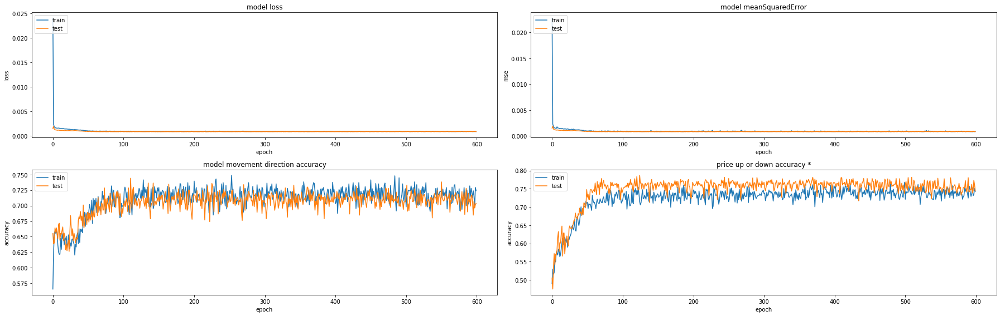

356/356 [==============================] - 2s 6ms/step - loss: 8.2701e-04 - mean_squared_error: 8.2701e-04 - movement_accuracy: 0.7135 - above_or_below_zero_accuracy: 0.7865
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


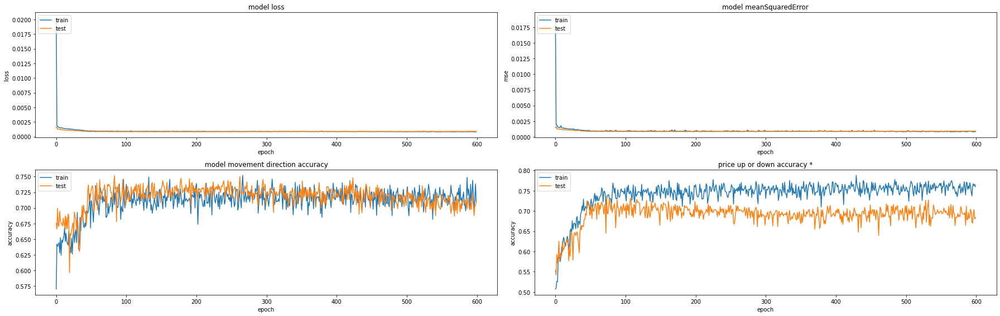

356/356 [==============================] - 2s 6ms/step - loss: 8.5935e-04 - mean_squared_error: 8.5935e-04 - movement_accuracy: 0.7388 - above_or_below_zero_accuracy: 0.7360
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


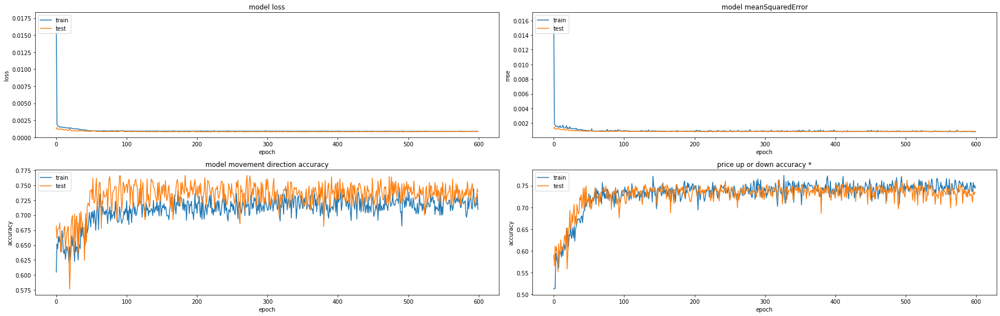

356/356 [==============================] - 2s 6ms/step - loss: 8.2614e-04 - mean_squared_error: 8.2614e-04 - movement_accuracy: 0.7331 - above_or_below_zero_accuracy: 0.7612
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


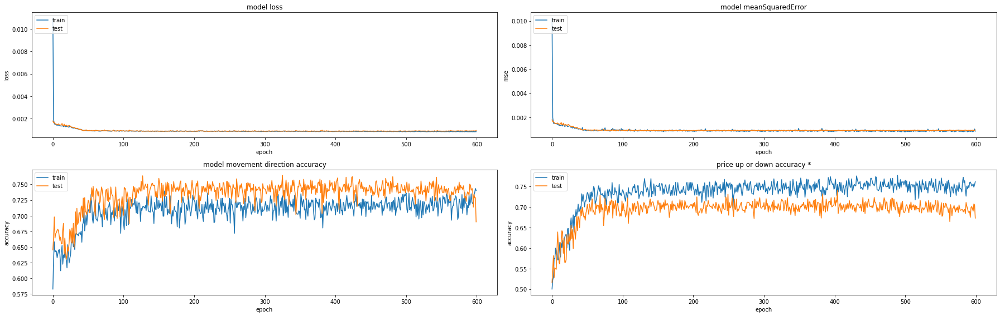

356/356 [==============================] - 2s 6ms/step - loss: 8.9158e-04 - mean_squared_error: 8.9158e-04 - movement_accuracy: 0.7416 - above_or_below_zero_accuracy: 0.7416
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


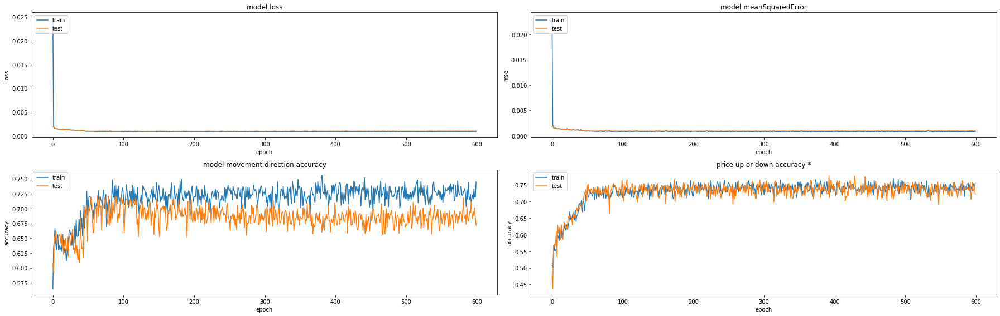

356/356 [==============================] - 2s 6ms/step - loss: 9.8271e-04 - mean_squared_error: 9.8271e-04 - movement_accuracy: 0.6798 - above_or_below_zero_accuracy: 0.7781
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


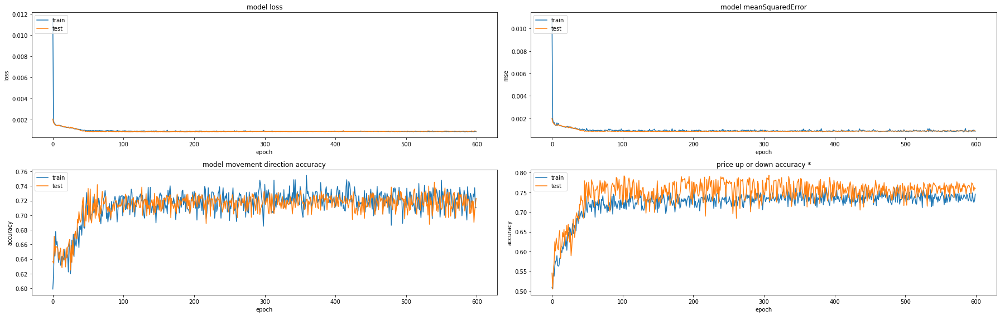

356/356 [==============================] - 2s 6ms/step - loss: 8.6141e-04 - mean_squared_error: 8.6141e-04 - movement_accuracy: 0.7331 - above_or_below_zero_accuracy: 0.7949
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


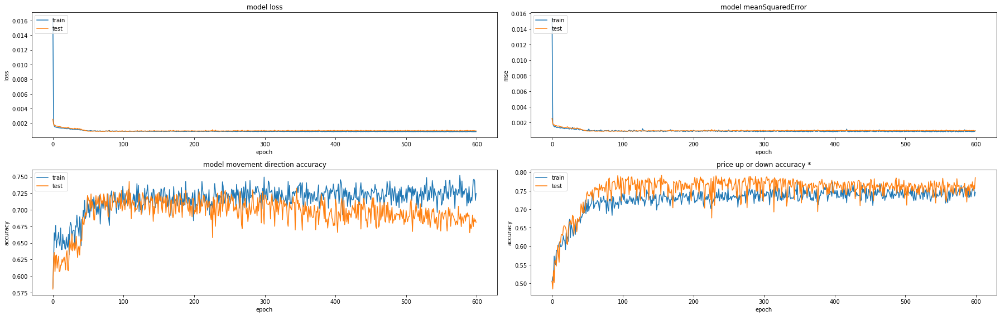

356/356 [==============================] - 2s 6ms/step - loss: 9.1422e-04 - mean_squared_error: 9.1422e-04 - movement_accuracy: 0.6938 - above_or_below_zero_accuracy: 0.7949

Results:

MeanSquaredError: [0.0009757184889167547, 0.0008224892662838101, 0.000927617191337049, 0.0007984747062437236, 0.000826005358248949, 0.000804122828412801, 0.0008763798396103084, 0.000949150649830699, 0.0008361064828932285, 0.0008790624560788274]
MovementDiretionAccuracy: [0.7893258333206177, 0.716292142868042, 0.75, 0.75, 0.75, 0.766853928565979, 0.7640449404716492, 0.7191011309623718, 0.7471910119056702, 0.7415730357170105]
AboveOrBellowAccuracy: [0.7780898809432983, 0.7584269642829895, 0.8061797618865967, 0.7865168452262878, 0.7359550595283508, 0.7612359523773193, 0.7415730357170105, 0.7780898809432983, 0.7949438095092773, 0.7949438095092773]

MeanSquaredError mean: 0.0008695127267856151
MovementDiretionAccuracy mean: 0.749438202381134
AboveOrBellowAccuracy mean: 0.7735954999923706

MeanSquaredError std

In [11]:
features = [variation, RSI_56]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


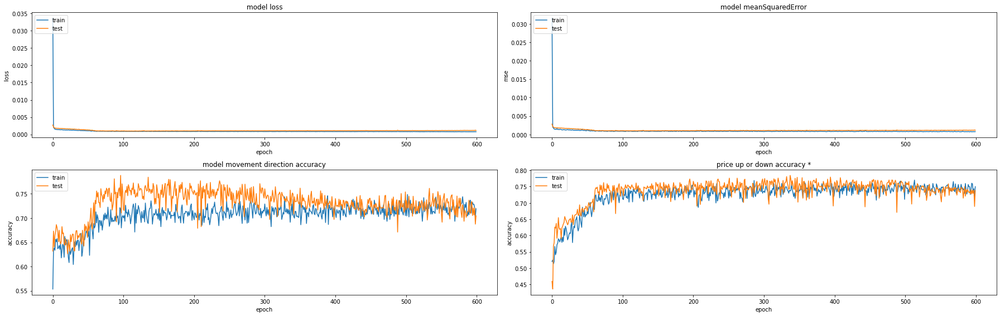

356/356 [==============================] - 2s 5ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7219 - above_or_below_zero_accuracy: 0.7865
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


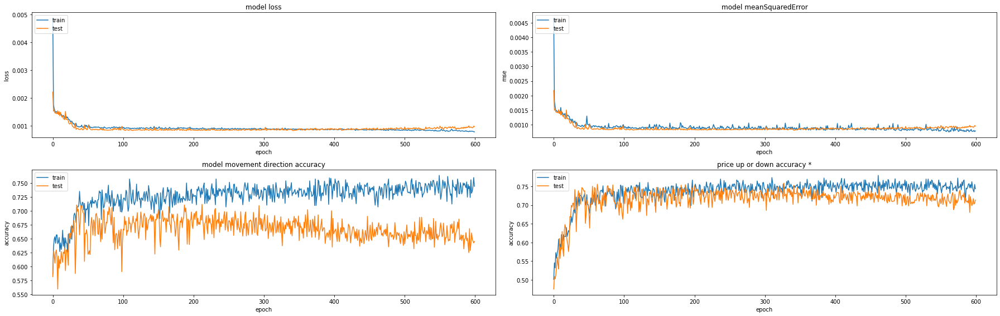

356/356 [==============================] - 2s 6ms/step - loss: 8.3980e-04 - mean_squared_error: 8.3980e-04 - movement_accuracy: 0.6798 - above_or_below_zero_accuracy: 0.7584
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


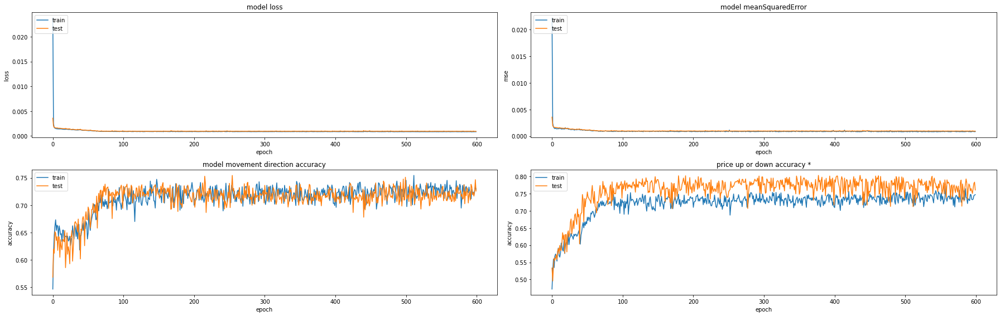

356/356 [==============================] - 2s 6ms/step - loss: 9.3317e-04 - mean_squared_error: 9.3317e-04 - movement_accuracy: 0.7275 - above_or_below_zero_accuracy: 0.8062
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


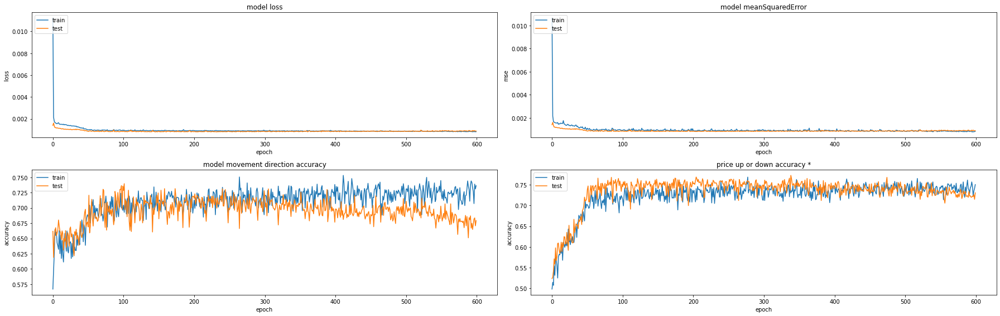

356/356 [==============================] - 2s 6ms/step - loss: 8.3689e-04 - mean_squared_error: 8.3689e-04 - movement_accuracy: 0.7135 - above_or_below_zero_accuracy: 0.7725
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


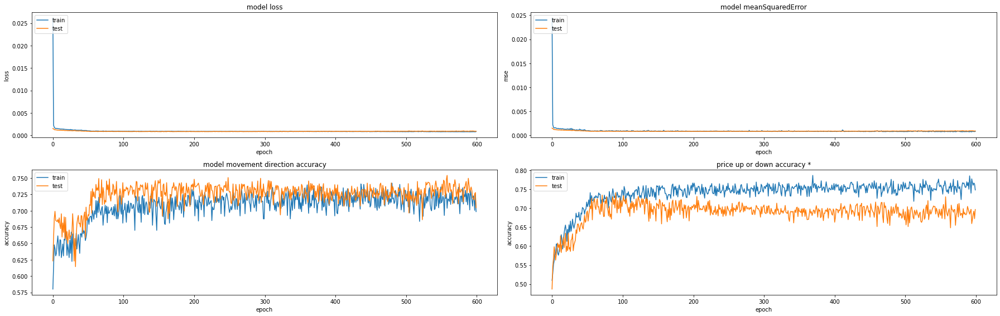

356/356 [==============================] - 2s 6ms/step - loss: 8.6109e-04 - mean_squared_error: 8.6109e-04 - movement_accuracy: 0.7444 - above_or_below_zero_accuracy: 0.7416
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


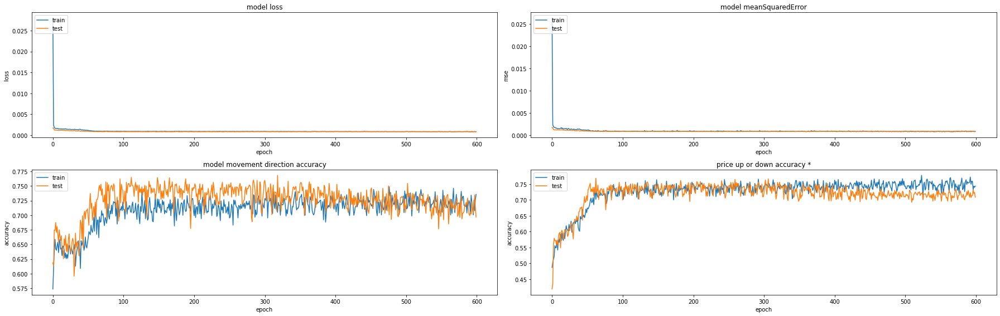

356/356 [==============================] - 2s 6ms/step - loss: 8.6311e-04 - mean_squared_error: 8.6311e-04 - movement_accuracy: 0.7275 - above_or_below_zero_accuracy: 0.7697
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


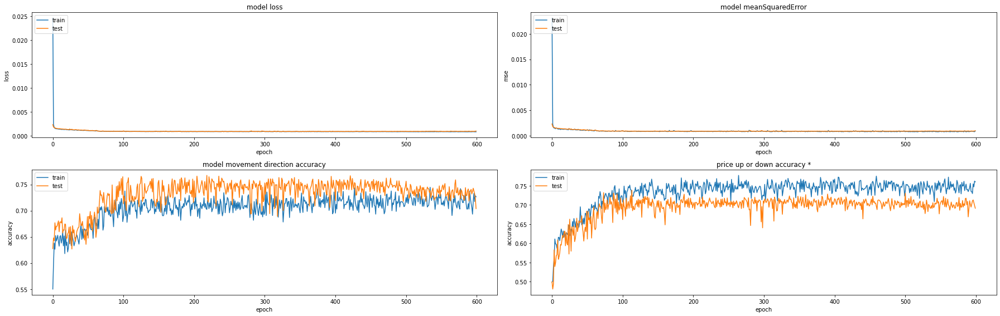

356/356 [==============================] - 2s 6ms/step - loss: 8.9784e-04 - mean_squared_error: 8.9784e-04 - movement_accuracy: 0.7303 - above_or_below_zero_accuracy: 0.7416
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


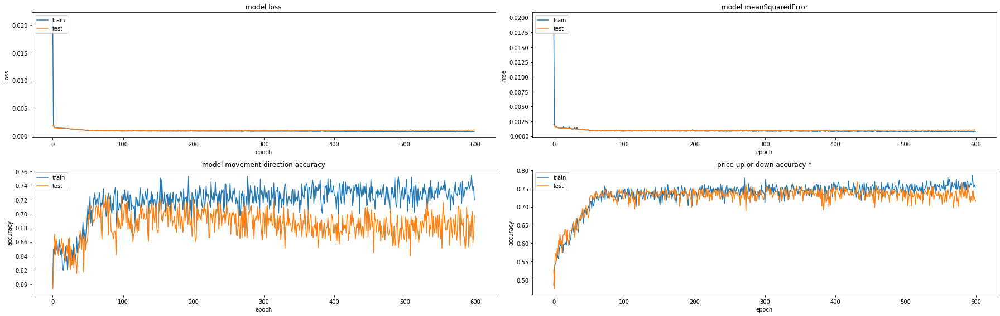

356/356 [==============================] - 2s 6ms/step - loss: 9.8690e-04 - mean_squared_error: 9.8690e-04 - movement_accuracy: 0.6770 - above_or_below_zero_accuracy: 0.7669
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


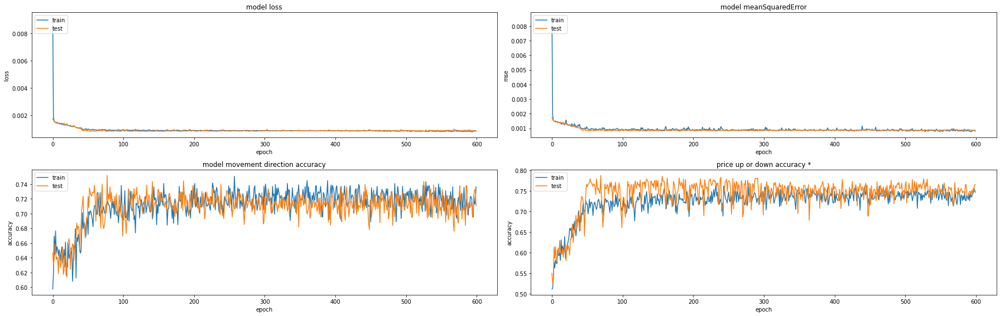

356/356 [==============================] - 2s 6ms/step - loss: 8.6049e-04 - mean_squared_error: 8.6049e-04 - movement_accuracy: 0.7275 - above_or_below_zero_accuracy: 0.7893
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


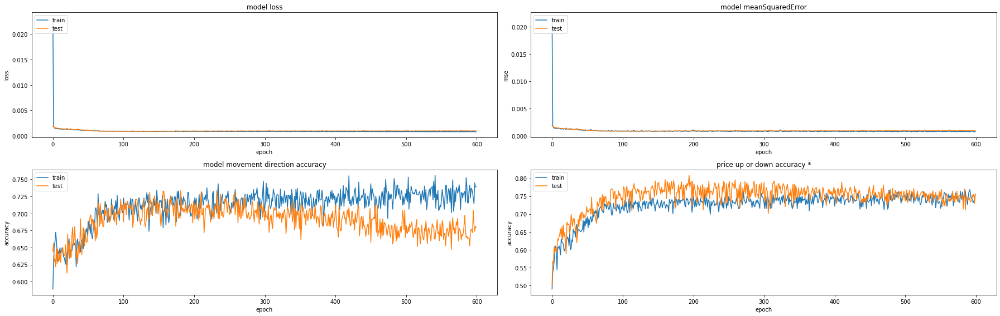

356/356 [==============================] - 2s 6ms/step - loss: 9.2011e-04 - mean_squared_error: 9.2011e-04 - movement_accuracy: 0.7022 - above_or_below_zero_accuracy: 0.8090

Results:

MeanSquaredError: [0.0009702360257506371, 0.000820729008410126, 0.0009127177181653678, 0.00080536596942693, 0.0008384758839383721, 0.0008059992687776685, 0.0008806841797195375, 0.0009470156510360539, 0.0008272843551822007, 0.0008867732831276953]
MovementDiretionAccuracy: [0.7865168452262878, 0.7134831547737122, 0.7556179761886597, 0.7443820238113403, 0.7528089880943298, 0.7696629166603088, 0.7696629166603088, 0.7247191071510315, 0.7528089880943298, 0.7303370833396912]
AboveOrBellowAccuracy: [0.7865168452262878, 0.7584269642829895, 0.8061797618865967, 0.7724719047546387, 0.7415730357170105, 0.7696629166603088, 0.7415730357170105, 0.766853928565979, 0.7893258333206177, 0.8089887499809265]

MeanSquaredError mean: 0.0008695281343534589
MovementDiretionAccuracy mean: 0.75
AboveOrBellowAccuracy mean: 0.7741572

In [12]:
features = [variation, RSI_56, RSI_28]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


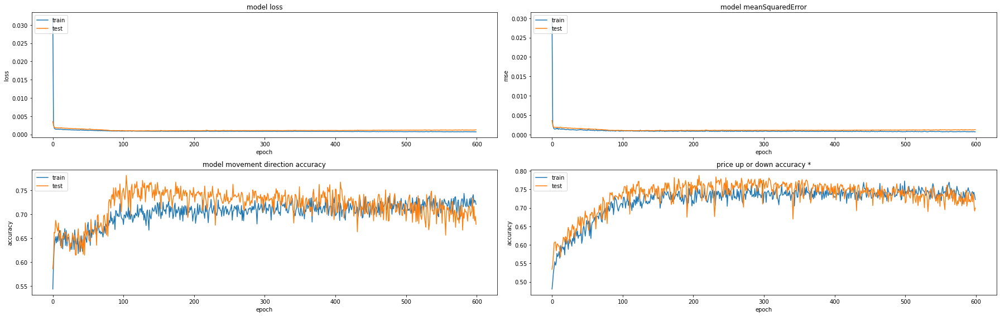

356/356 [==============================] - 2s 5ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7444 - above_or_below_zero_accuracy: 0.7893    
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


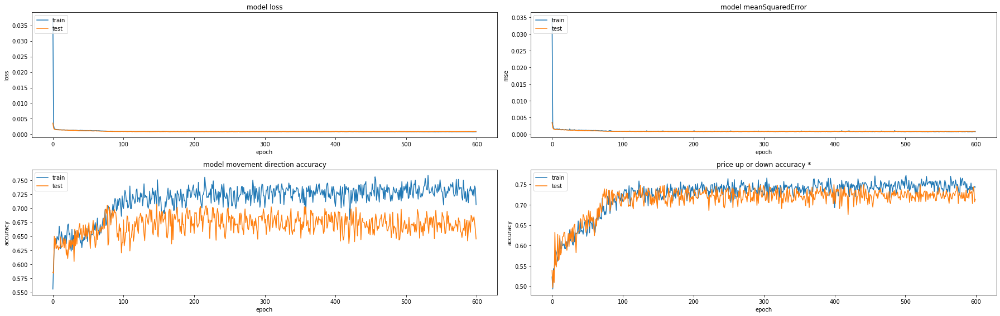

356/356 [==============================] - 2s 5ms/step - loss: 8.6417e-04 - mean_squared_error: 8.6417e-04 - movement_accuracy: 0.6910 - above_or_below_zero_accuracy: 0.7528
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


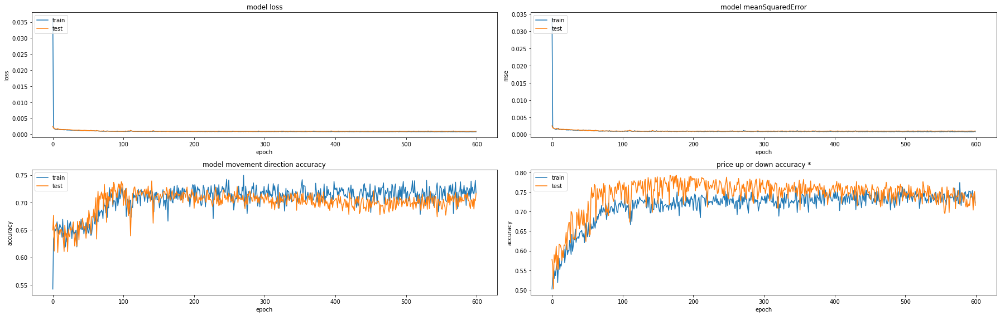

356/356 [==============================] - 2s 6ms/step - loss: 9.4586e-04 - mean_squared_error: 9.4586e-04 - movement_accuracy: 0.7079 - above_or_below_zero_accuracy: 0.7949
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


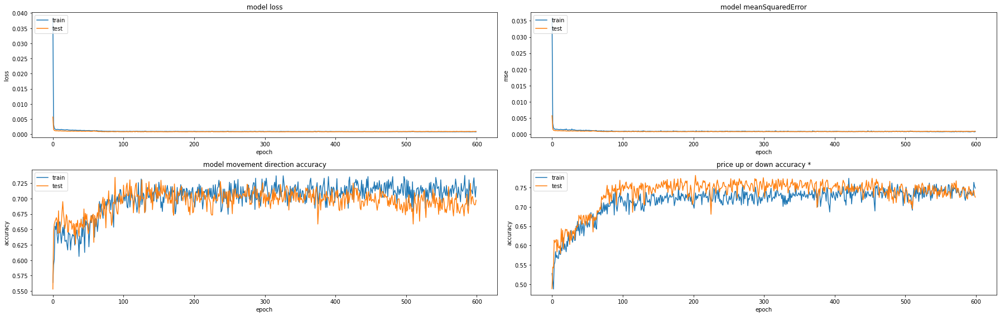

356/356 [==============================] - 2s 6ms/step - loss: 8.2715e-04 - mean_squared_error: 8.2715e-04 - movement_accuracy: 0.7107 - above_or_below_zero_accuracy: 0.7809
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


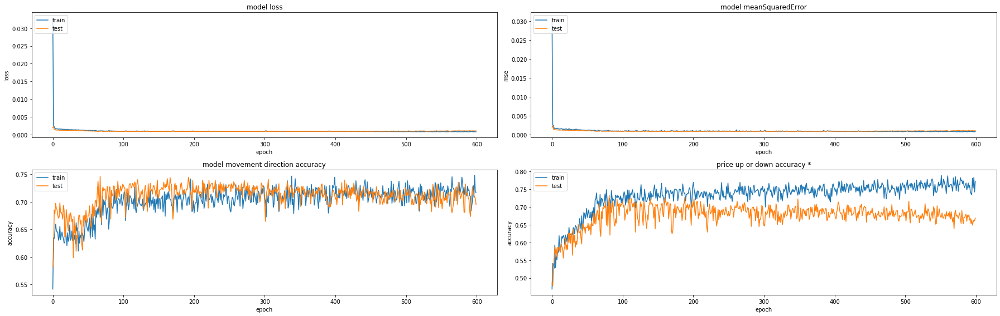

356/356 [==============================] - 2s 6ms/step - loss: 8.6420e-04 - mean_squared_error: 8.6420e-04 - movement_accuracy: 0.7275 - above_or_below_zero_accuracy: 0.7303
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


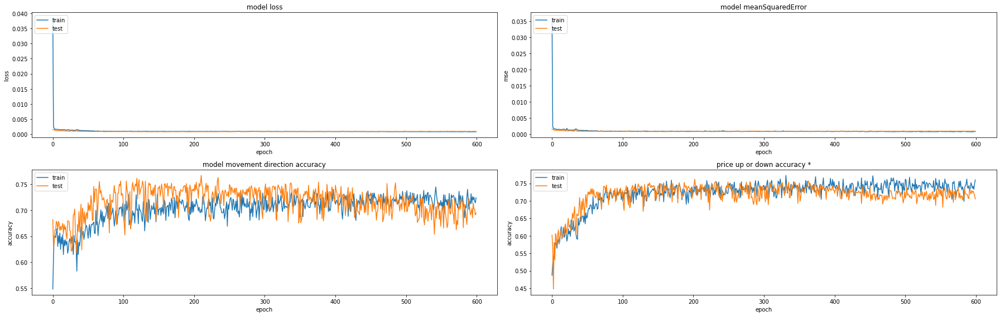

356/356 [==============================] - 2s 6ms/step - loss: 8.3888e-04 - mean_squared_error: 8.3888e-04 - movement_accuracy: 0.7388 - above_or_below_zero_accuracy: 0.7612
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


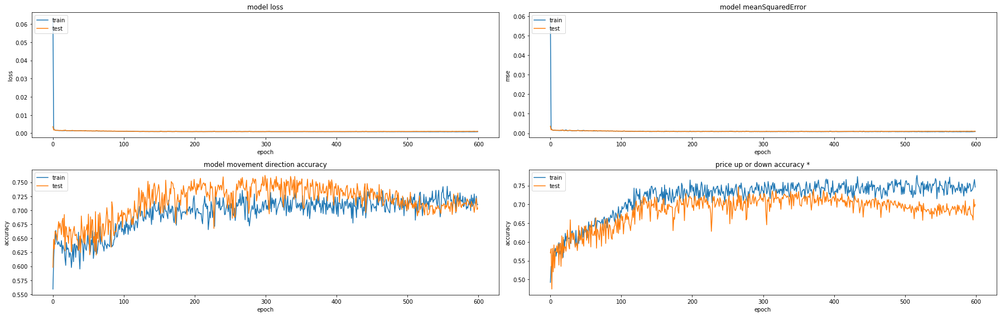

356/356 [==============================] - 2s 6ms/step - loss: 8.9212e-04 - mean_squared_error: 8.9212e-04 - movement_accuracy: 0.7584 - above_or_below_zero_accuracy: 0.7472
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


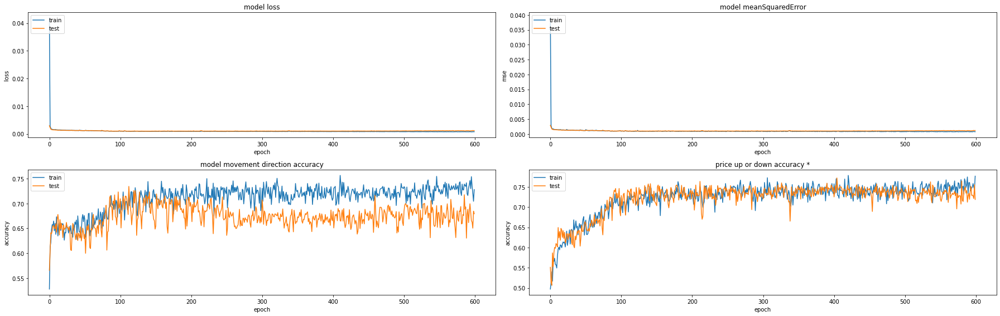

356/356 [==============================] - 2s 6ms/step - loss: 9.8151e-04 - mean_squared_error: 9.8151e-04 - movement_accuracy: 0.6742 - above_or_below_zero_accuracy: 0.7725
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


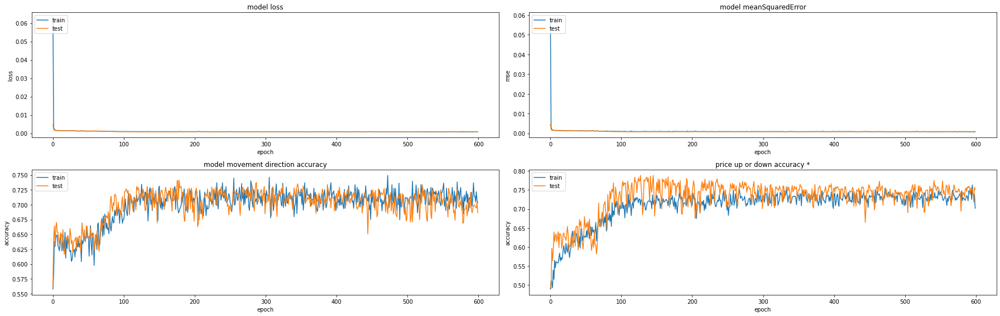

356/356 [==============================] - 2s 6ms/step - loss: 8.4971e-04 - mean_squared_error: 8.4971e-04 - movement_accuracy: 0.7275 - above_or_below_zero_accuracy: 0.7865
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


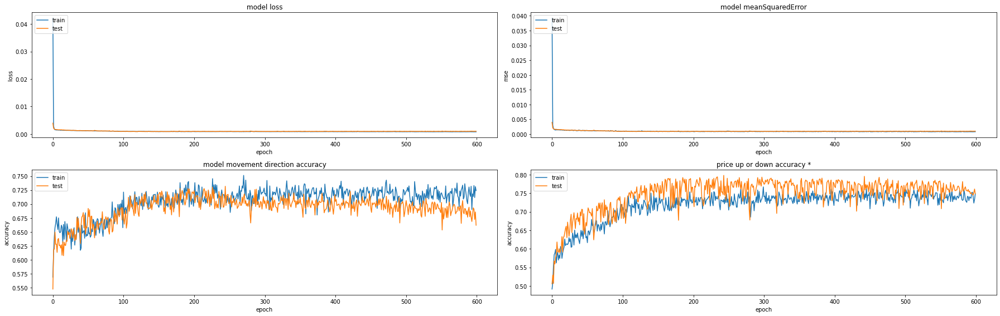

356/356 [==============================] - 2s 6ms/step - loss: 9.4014e-04 - mean_squared_error: 9.4014e-04 - movement_accuracy: 0.7022 - above_or_below_zero_accuracy: 0.7978

Results:

MeanSquaredError: [0.0009795400546863675, 0.0008484327117912471, 0.0009298561490140855, 0.0008124768501147628, 0.0008266574004665017, 0.0008136450196616352, 0.0008907178998924792, 0.0009592771530151367, 0.0008340903441421688, 0.0008891016477718949]
MovementDiretionAccuracy: [0.7780898809432983, 0.7078651785850525, 0.7415730357170105, 0.7387640476226807, 0.7471910119056702, 0.766853928565979, 0.7640449404716492, 0.733146071434021, 0.7443820238113403, 0.7303370833396912]
AboveOrBellowAccuracy: [0.7893258333206177, 0.7528089880943298, 0.7949438095092773, 0.7808988690376282, 0.7303370833396912, 0.7612359523773193, 0.7471910119056702, 0.7724719047546387, 0.7865168452262878, 0.7977527976036072]

MeanSquaredError mean: 0.000878379523055628
MovementDiretionAccuracy mean: 0.7452247202396393
AboveOrBellowAccuracy 

In [13]:
features = [variation, RSI_56, STOCHk_56]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

## Tron

In [14]:
base_coin_str = 'TRX'
base_coin_fullname_str = 'tron'

df = load_data(base_coin_str, base_coin_fullname_str, event_days_left_lookback=7, storage_folder='../data', events_query=query_str)
variation = df.loc[:, 'price (%)'].to_numpy()
volume_variation = df['Volume'].pct_change().fillna(0).to_numpy()

features_set, _ = to_keras_format([variation], variation)
shuffle_mask = np.arange(len(features_set))
np.random.shuffle(shuffle_mask)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


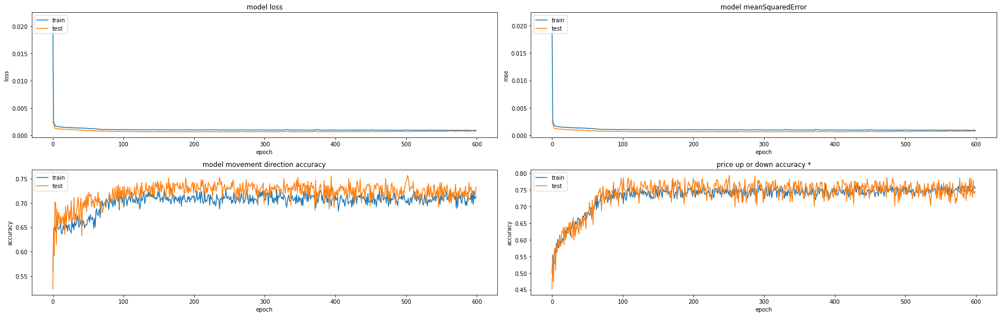

224/224 [==============================] - 1s 5ms/step - loss: 6.2422e-04 - mean_squared_error: 6.2422e-04 - movement_accuracy: 0.7321 - above_or_below_zero_accuracy: 0.7902
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


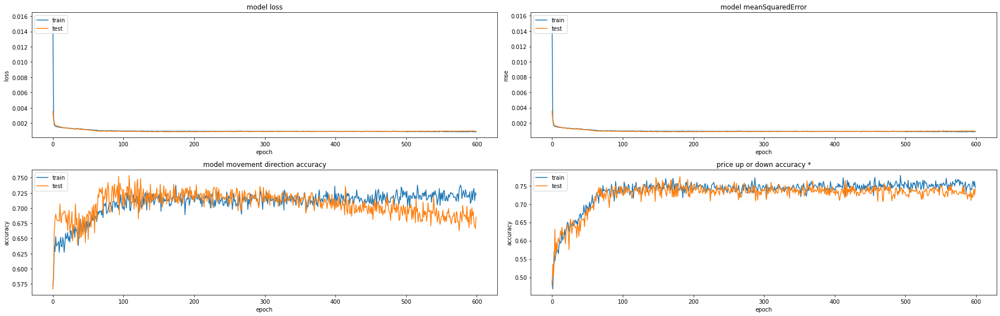

224/224 [==============================] - 1s 5ms/step - loss: 8.6198e-04 - mean_squared_error: 8.6198e-04 - movement_accuracy: 0.7143 - above_or_below_zero_accuracy: 0.7768
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


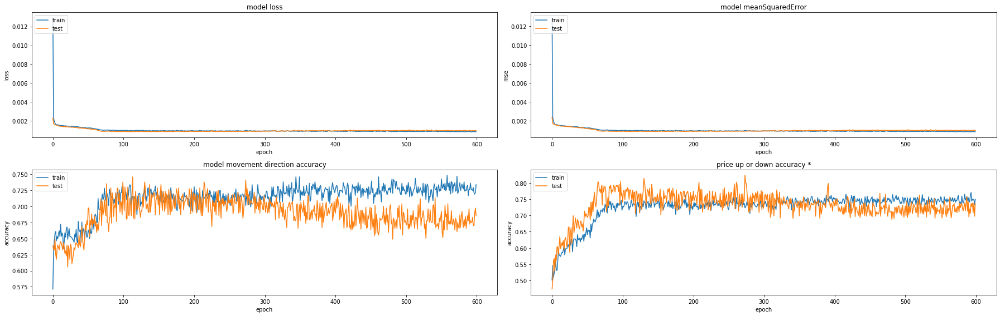

223/223 [==============================] - 1s 6ms/step - loss: 8.7698e-04 - mean_squared_error: 8.7698e-04 - movement_accuracy: 0.7444 - above_or_below_zero_accuracy: 0.8251
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


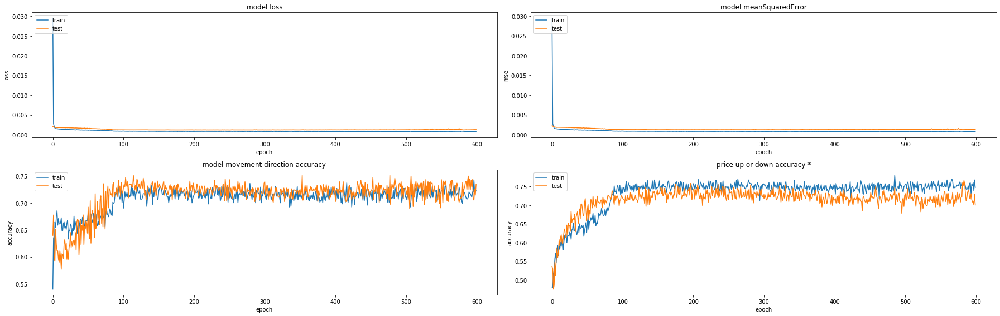

223/223 [==============================] - 1s 6ms/step - loss: 0.0012 - mean_squared_error: 0.0012 - movement_accuracy: 0.7399 - above_or_below_zero_accuracy: 0.7578
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


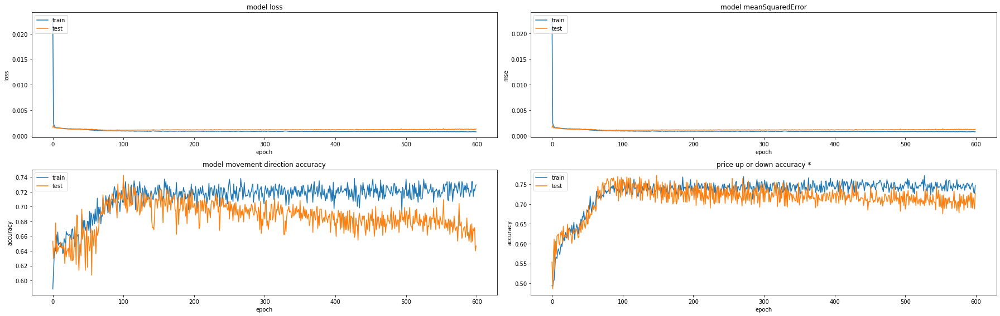

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6951 - above_or_below_zero_accuracy: 0.7668
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


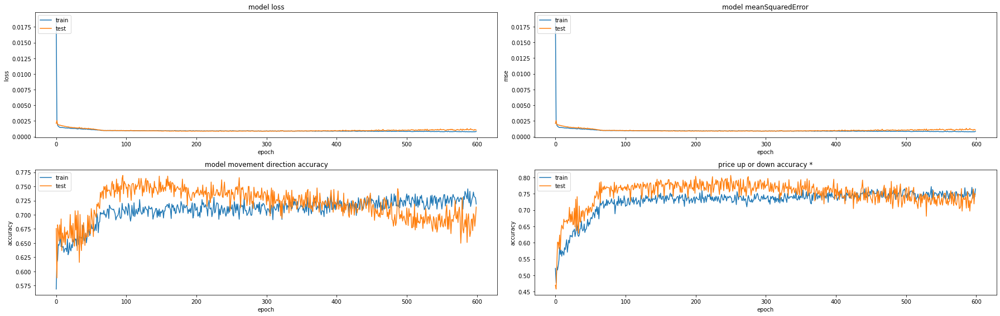

224/224 [==============================] - 1s 6ms/step - loss: 8.6504e-04 - mean_squared_error: 8.6504e-04 - movement_accuracy: 0.7455 - above_or_below_zero_accuracy: 0.8036
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


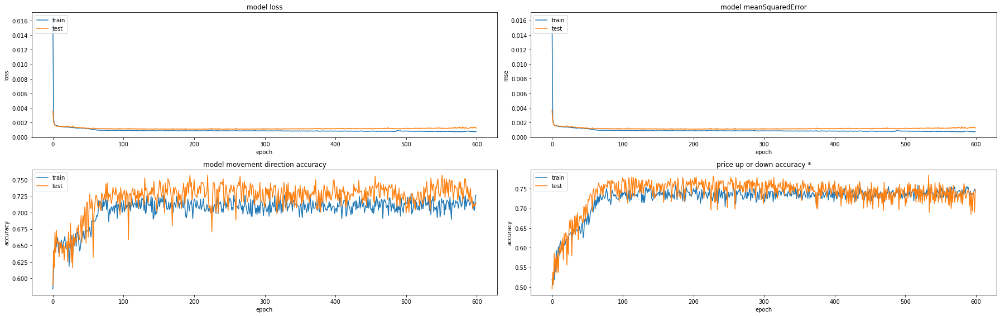

224/224 [==============================] - 1s 6ms/step - loss: 0.0012 - mean_squared_error: 0.0012 - movement_accuracy: 0.7277 - above_or_below_zero_accuracy: 0.7812
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


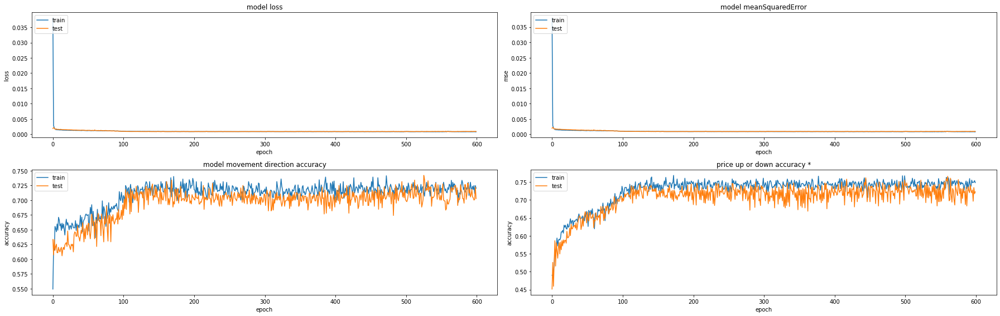

223/223 [==============================] - 1s 6ms/step - loss: 9.0407e-04 - mean_squared_error: 9.0407e-04 - movement_accuracy: 0.6951 - above_or_below_zero_accuracy: 0.7623
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


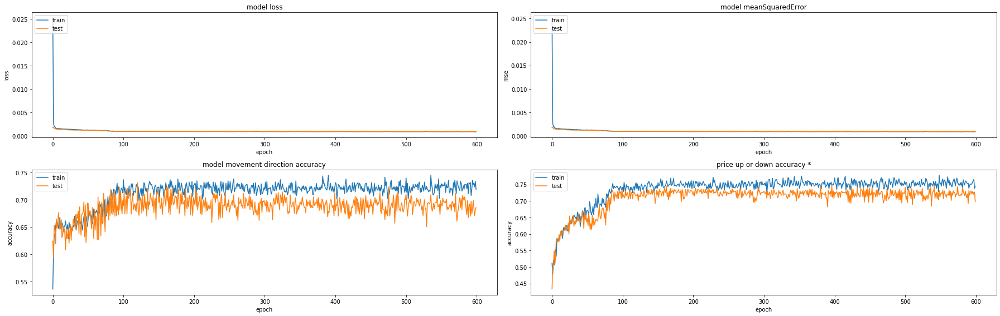

223/223 [==============================] - 1s 6ms/step - loss: 9.1336e-04 - mean_squared_error: 9.1336e-04 - movement_accuracy: 0.6906 - above_or_below_zero_accuracy: 0.7399
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


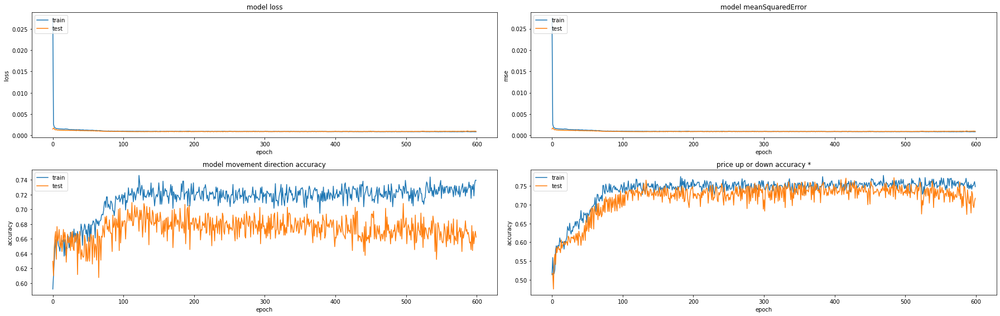

223/223 [==============================] - 1s 6ms/step - loss: 8.7992e-04 - mean_squared_error: 8.7992e-04 - movement_accuracy: 0.6816 - above_or_below_zero_accuracy: 0.7668

Results:

MeanSquaredError: [0.0006208477425388992, 0.0008583024027757347, 0.0008235055720433593, 0.0011882465332746506, 0.001032547326758504, 0.0008599787252023816, 0.0010587648721411824, 0.0008891883189789951, 0.0008900794200599194, 0.000852235418278724]
MovementDiretionAccuracy: [0.7589285969734192, 0.75, 0.7488788962364197, 0.7578475475311279, 0.7399103045463562, 0.7678571343421936, 0.7544642686843872, 0.7399103045463562, 0.7354260087013245, 0.713004469871521]
AboveOrBellowAccuracy: [0.7901785969734192, 0.7767857313156128, 0.8251121044158936, 0.7578475475311279, 0.7668161392211914, 0.8035714030265808, 0.78125, 0.7623318433761597, 0.7399103045463562, 0.7668161392211914]

MeanSquaredError mean: 0.000907369633205235
MovementDiretionAccuracy mean: 0.7466227531433105
AboveOrBellowAccuracy mean: 0.7770619809627533



In [15]:
features = [variation, RSI_56]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


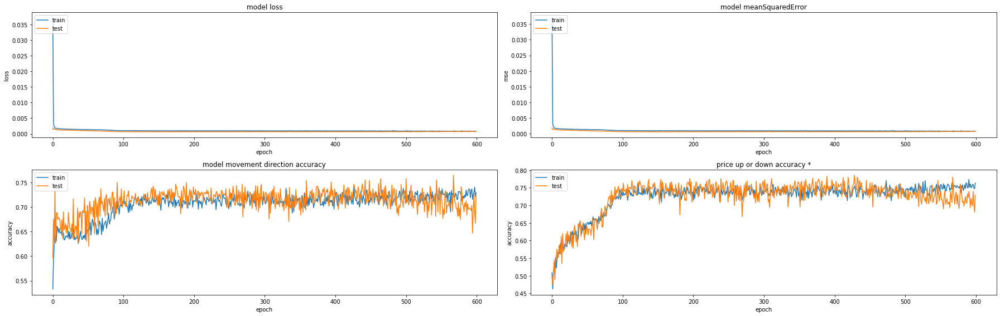

224/224 [==============================] - 1s 5ms/step - loss: 6.5385e-04 - mean_squared_error: 6.5385e-04 - movement_accuracy: 0.7321 - above_or_below_zero_accuracy: 0.7812
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


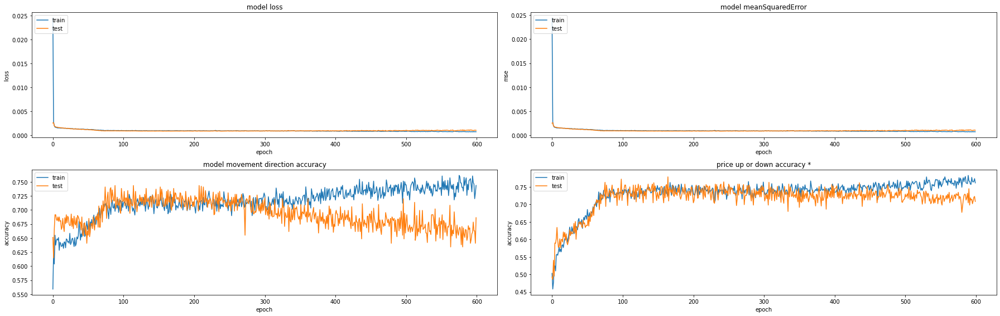

224/224 [==============================] - 1s 5ms/step - loss: 8.5568e-04 - mean_squared_error: 8.5568e-04 - movement_accuracy: 0.7143 - above_or_below_zero_accuracy: 0.7812
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


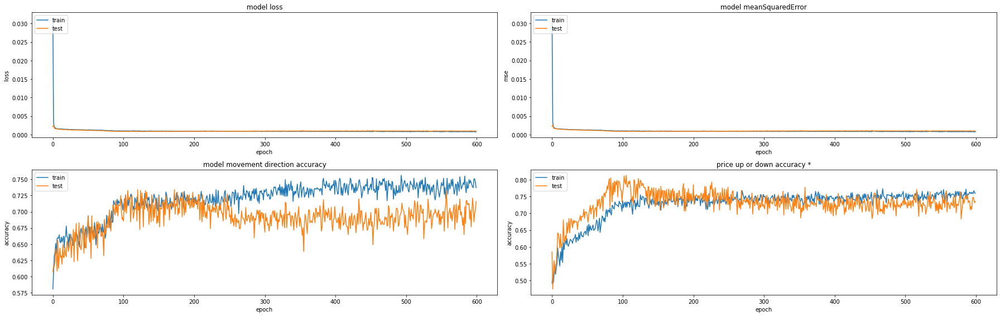

223/223 [==============================] - 1s 6ms/step - loss: 8.4392e-04 - mean_squared_error: 8.4392e-04 - movement_accuracy: 0.7175 - above_or_below_zero_accuracy: 0.8161
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


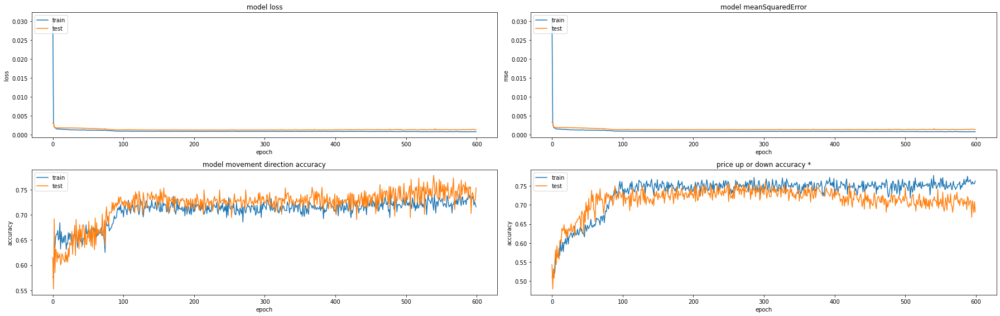

223/223 [==============================] - 1s 6ms/step - loss: 0.0012 - mean_squared_error: 0.0012 - movement_accuracy: 0.7354 - above_or_below_zero_accuracy: 0.7534
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


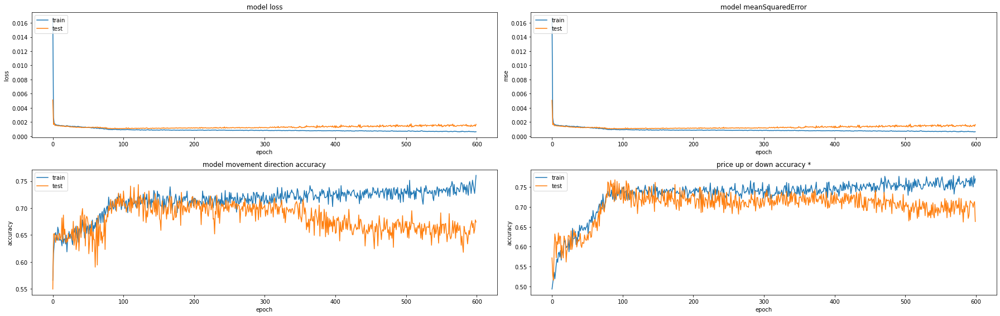

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7175 - above_or_below_zero_accuracy: 0.7623
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


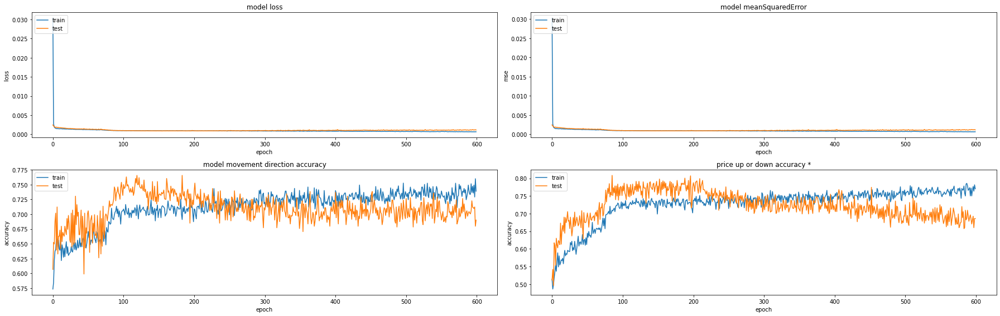

224/224 [==============================] - 1s 6ms/step - loss: 9.9436e-04 - mean_squared_error: 9.9436e-04 - movement_accuracy: 0.7188 - above_or_below_zero_accuracy: 0.8036
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


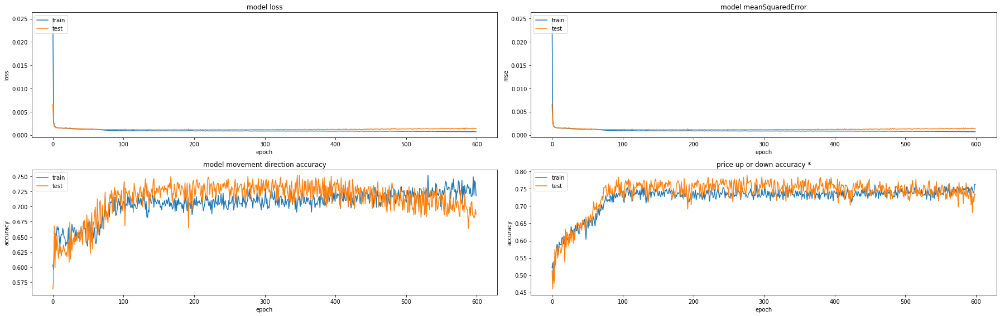

224/224 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7455 - above_or_below_zero_accuracy: 0.7857    
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


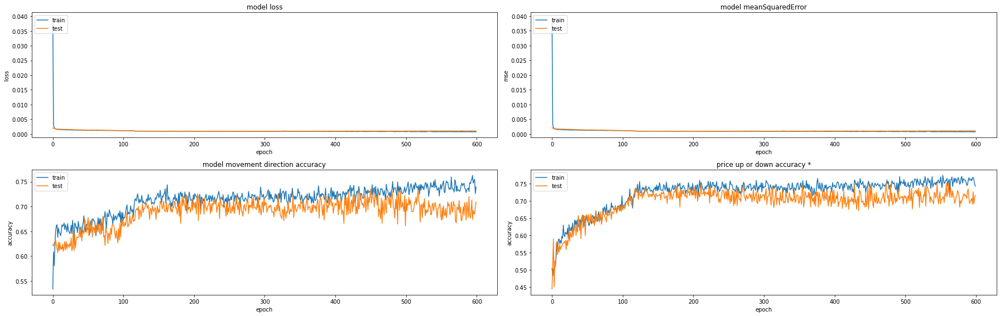

223/223 [==============================] - 1s 6ms/step - loss: 9.3514e-04 - mean_squared_error: 9.3514e-04 - movement_accuracy: 0.7220 - above_or_below_zero_accuracy: 0.7534
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


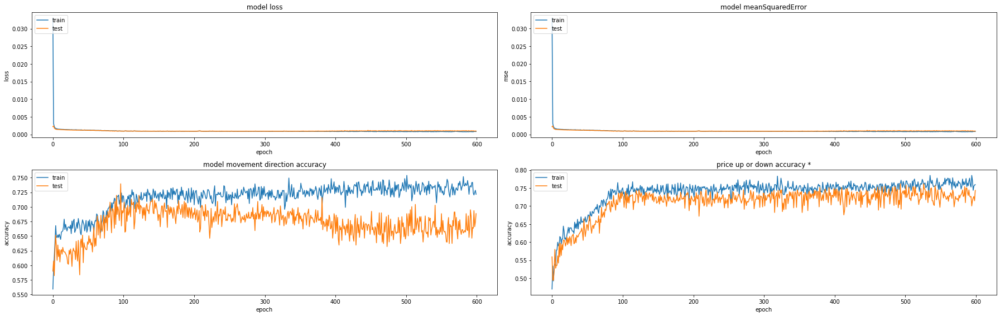

223/223 [==============================] - 1s 6ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.6547 - above_or_below_zero_accuracy: 0.7578
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


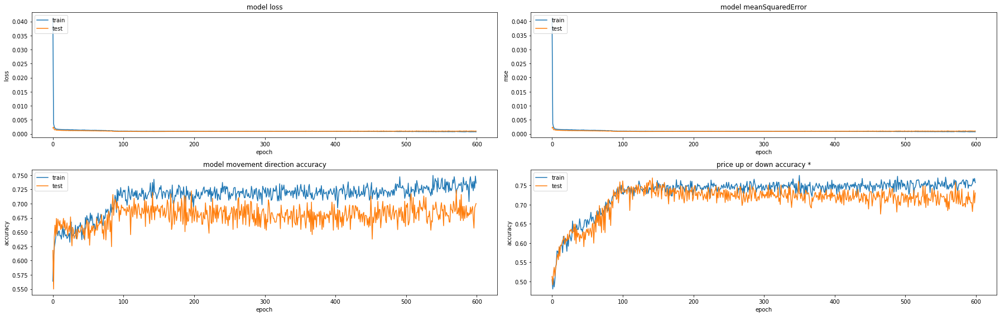

223/223 [==============================] - 1s 6ms/step - loss: 8.4604e-04 - mean_squared_error: 8.4604e-04 - movement_accuracy: 0.6861 - above_or_below_zero_accuracy: 0.7668

Results:

MeanSquaredError: [0.0006308499141596258, 0.0008471960900351405, 0.0008263363852165639, 0.0011774407466873527, 0.0010484212543815374, 0.0008698501624166965, 0.0010546623962000012, 0.000905526103451848, 0.0008952589123509824, 0.0008344442467205226]
MovementDiretionAccuracy: [0.7633928656578064, 0.7410714030265808, 0.7399103045463562, 0.7847533822059631, 0.7399103045463562, 0.7678571343421936, 0.75, 0.7354260087013245, 0.7399103045463562, 0.7219731211662292]
AboveOrBellowAccuracy: [0.78125, 0.78125, 0.8161435127258301, 0.7533632516860962, 0.7623318433761597, 0.8035714030265808, 0.7857142686843872, 0.7533632516860962, 0.7578475475311279, 0.7668161392211914]

MeanSquaredError mean: 0.0009089986211620271
MovementDiretionAccuracy mean: 0.7484204828739166
AboveOrBellowAccuracy mean: 0.776165121793747

MeanSquar

In [16]:
features = [variation, RSI_56, RSI_28]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


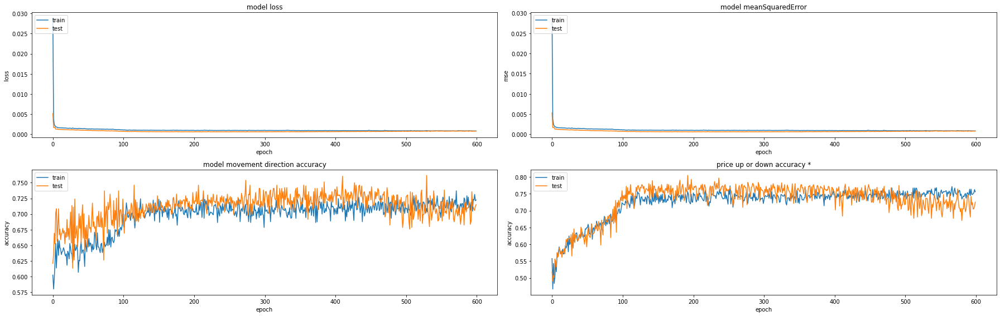

224/224 [==============================] - 1s 5ms/step - loss: 6.2511e-04 - mean_squared_error: 6.2511e-04 - movement_accuracy: 0.7143 - above_or_below_zero_accuracy: 0.8036
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


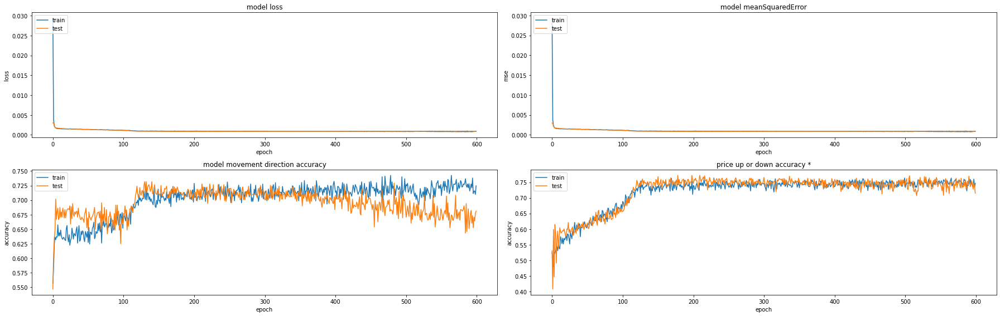

224/224 [==============================] - 1s 6ms/step - loss: 8.6037e-04 - mean_squared_error: 8.6037e-04 - movement_accuracy: 0.7143 - above_or_below_zero_accuracy: 0.7768
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


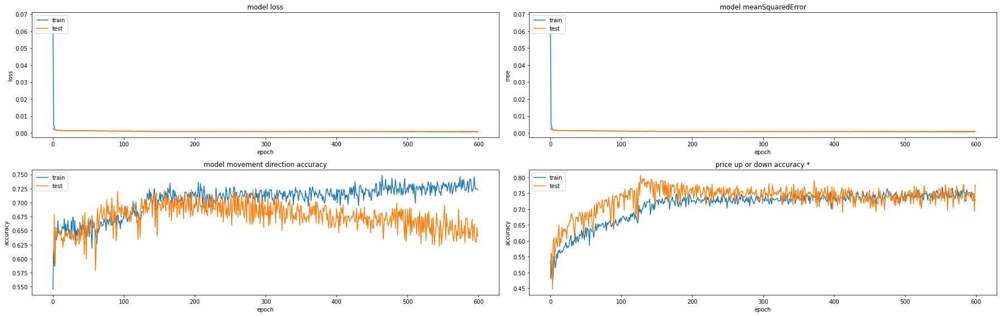

223/223 [==============================] - 1s 6ms/step - loss: 9.4141e-04 - mean_squared_error: 9.4141e-04 - movement_accuracy: 0.6951 - above_or_below_zero_accuracy: 0.8072
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


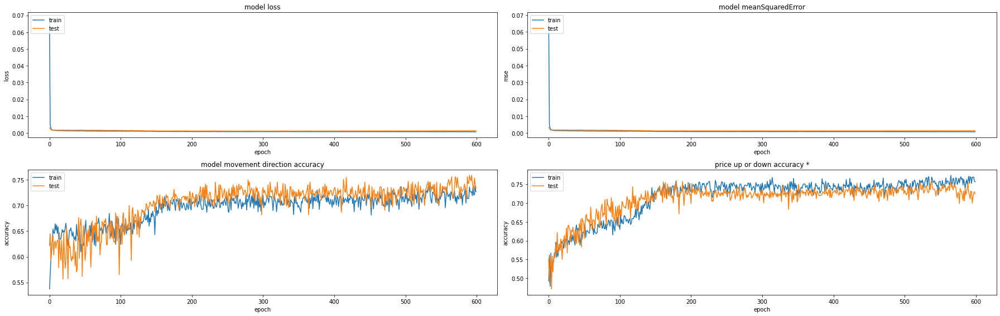

223/223 [==============================] - 1s 6ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - movement_accuracy: 0.7399 - above_or_below_zero_accuracy: 0.7578
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


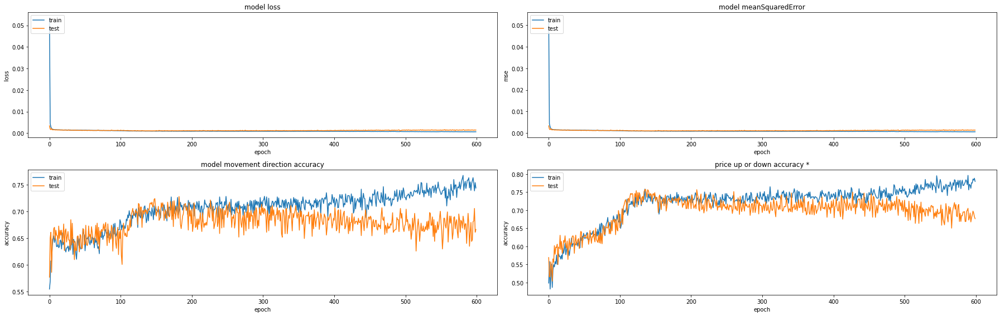

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7040 - above_or_below_zero_accuracy: 0.7534
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


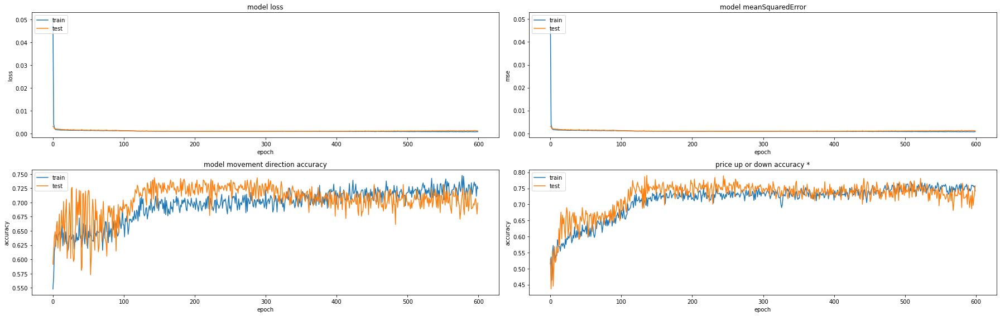

224/224 [==============================] - 1s 6ms/step - loss: 9.7675e-04 - mean_squared_error: 9.7675e-04 - movement_accuracy: 0.7277 - above_or_below_zero_accuracy: 0.7902
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


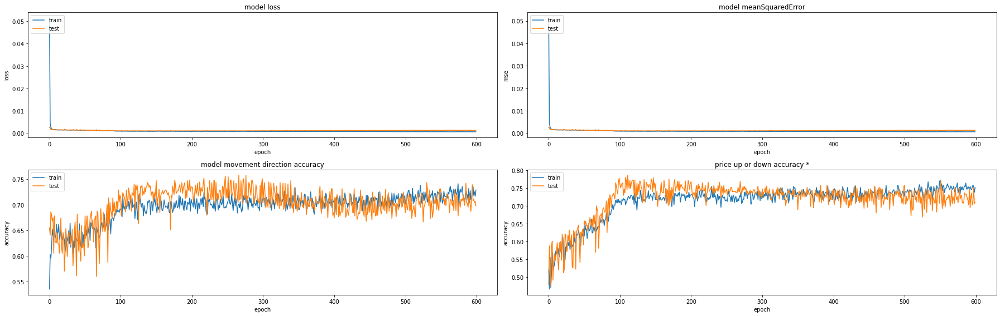

224/224 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7321 - above_or_below_zero_accuracy: 0.7812    
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


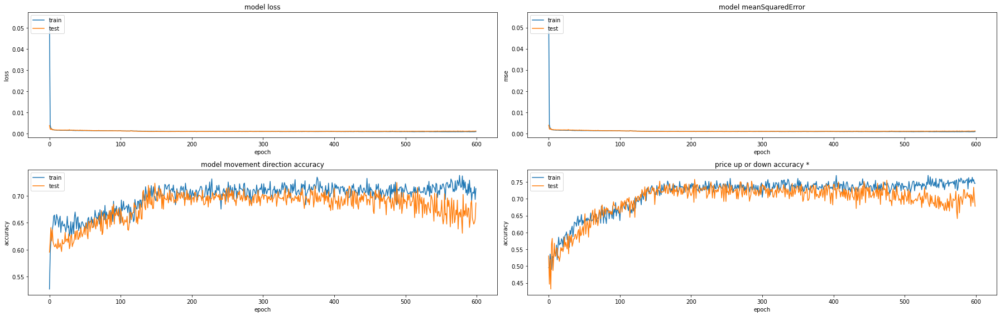

223/223 [==============================] - 1s 6ms/step - loss: 9.0389e-04 - mean_squared_error: 9.0389e-04 - movement_accuracy: 0.7085 - above_or_below_zero_accuracy: 0.7578
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


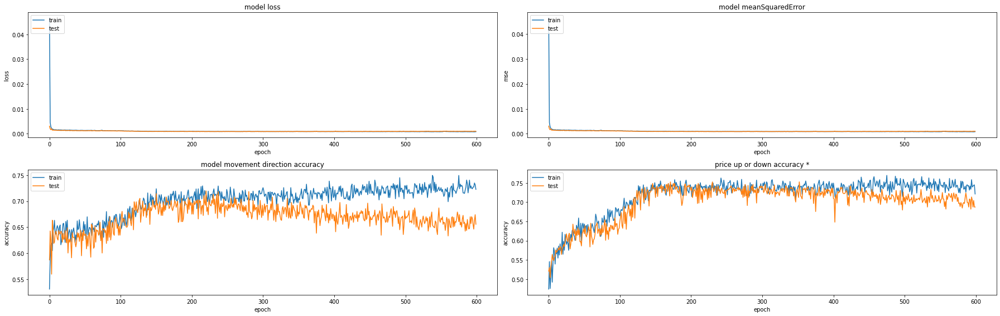

223/223 [==============================] - 1s 6ms/step - loss: 8.9379e-04 - mean_squared_error: 8.9379e-04 - movement_accuracy: 0.6996 - above_or_below_zero_accuracy: 0.7489
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


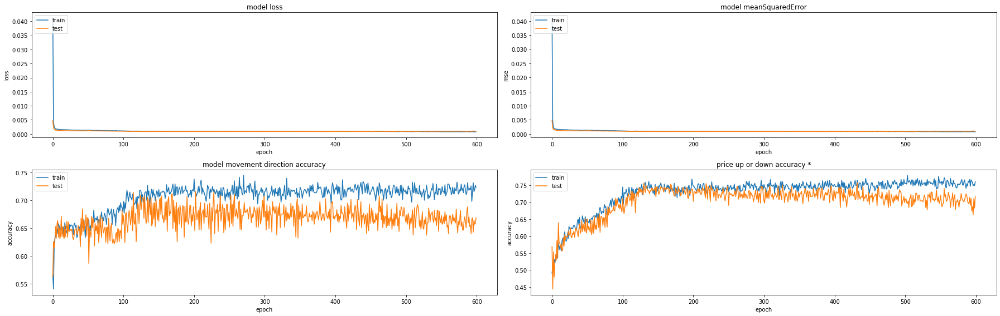

223/223 [==============================] - 1s 6ms/step - loss: 8.7782e-04 - mean_squared_error: 8.7782e-04 - movement_accuracy: 0.6816 - above_or_below_zero_accuracy: 0.7534

Results:

MeanSquaredError: [0.000619211234152317, 0.000847371353302151, 0.0008282507187686861, 0.0011765016242861748, 0.0010450533591210842, 0.0008918445673771203, 0.0010669894982129335, 0.0008826607372611761, 0.0008795018075034022, 0.0008575014071539044]
MovementDiretionAccuracy: [0.7633928656578064, 0.7276785969734192, 0.7309417128562927, 0.7668161392211914, 0.726457417011261, 0.7410714030265808, 0.7589285969734192, 0.7309417128562927, 0.726457417011261, 0.7219731211662292]
AboveOrBellowAccuracy: [0.8035714030265808, 0.7767857313156128, 0.8071748614311218, 0.7578475475311279, 0.7533632516860962, 0.7901785969734192, 0.78125, 0.7578475475311279, 0.7488788962364197, 0.7533632516860962]

MeanSquaredError mean: 0.0009094886307138949
MovementDiretionAccuracy mean: 0.7394658982753753
AboveOrBellowAccuracy mean: 0.7730

In [17]:
features = [variation, RSI_56, STOCHk_56]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

## EOS

In [18]:
base_coin_str = 'EOS'
base_coin_fullname_str = 'EOS'

df = load_data(base_coin_str, base_coin_fullname_str, event_days_left_lookback=7, storage_folder='../data', events_query=query_str)
variation = df.loc[:, 'price (%)'].to_numpy()
volume_variation = df['Volume'].pct_change().fillna(0).to_numpy()

features_set, _ = to_keras_format([variation], variation)
shuffle_mask = np.arange(len(features_set))
np.random.shuffle(shuffle_mask)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


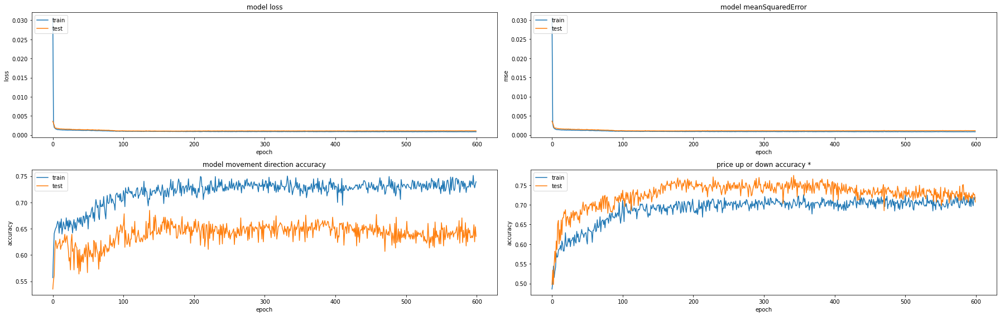

224/224 [==============================] - 1s 5ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.6607 - above_or_below_zero_accuracy: 0.7723    
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


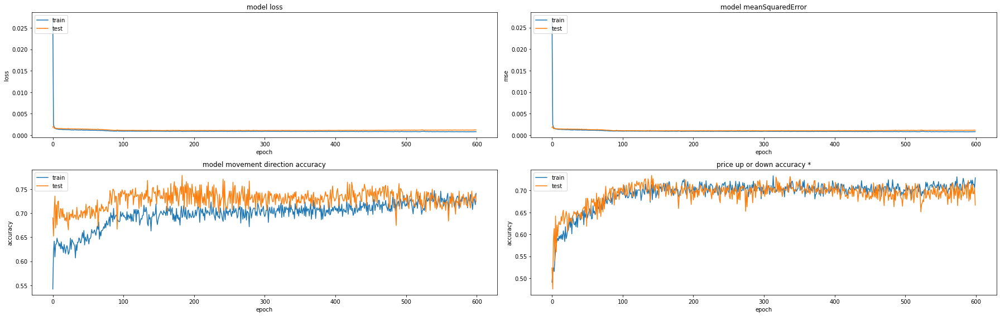

224/224 [==============================] - 1s 5ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7455 - above_or_below_zero_accuracy: 0.7411
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


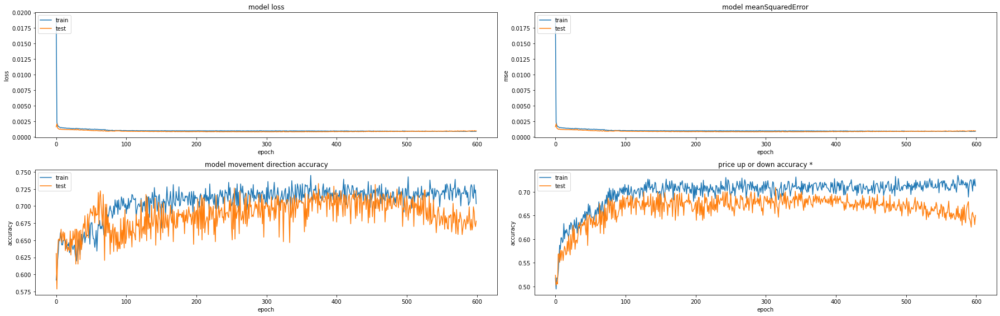

223/223 [==============================] - 1s 6ms/step - loss: 7.9324e-04 - mean_squared_error: 7.9324e-04 - movement_accuracy: 0.6951 - above_or_below_zero_accuracy: 0.7130
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


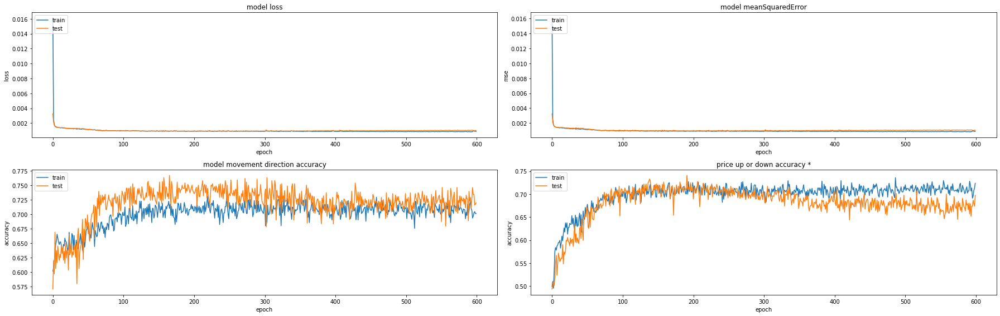

223/223 [==============================] - 1s 6ms/step - loss: 9.4398e-04 - mean_squared_error: 9.4398e-04 - movement_accuracy: 0.7444 - above_or_below_zero_accuracy: 0.7399
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


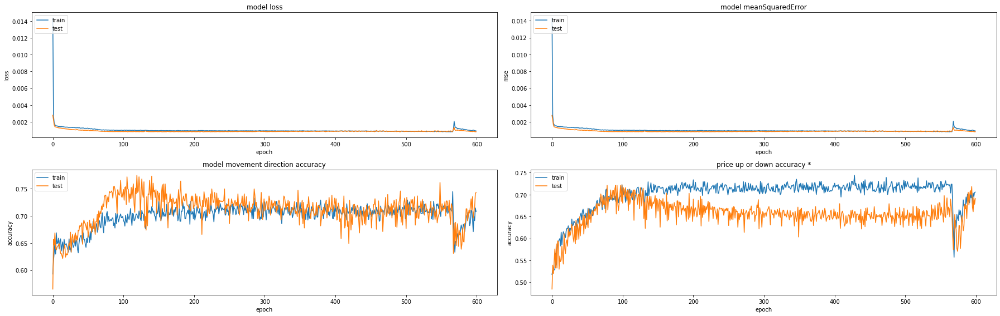

223/223 [==============================] - 1s 6ms/step - loss: 8.4737e-04 - mean_squared_error: 8.4737e-04 - movement_accuracy: 0.7444 - above_or_below_zero_accuracy: 0.7220
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


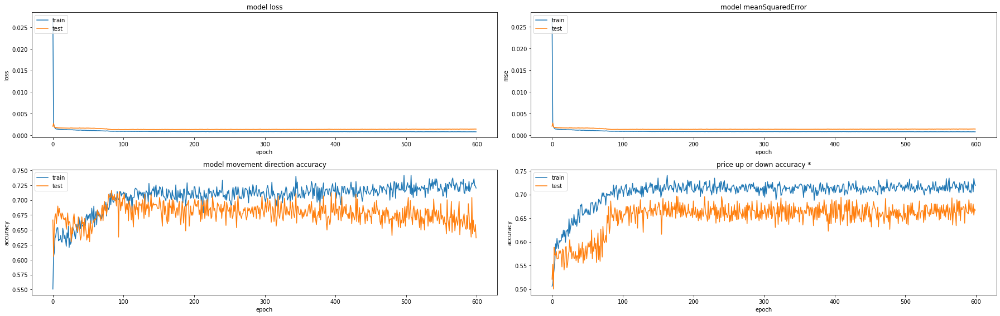

224/224 [==============================] - 1s 6ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - movement_accuracy: 0.6875 - above_or_below_zero_accuracy: 0.7054
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


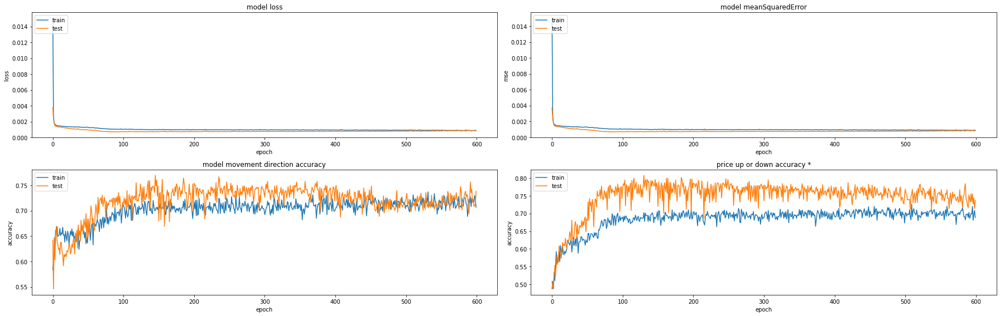

224/224 [==============================] - 1s 6ms/step - loss: 7.0482e-04 - mean_squared_error: 7.0482e-04 - movement_accuracy: 0.7098 - above_or_below_zero_accuracy: 0.8036
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


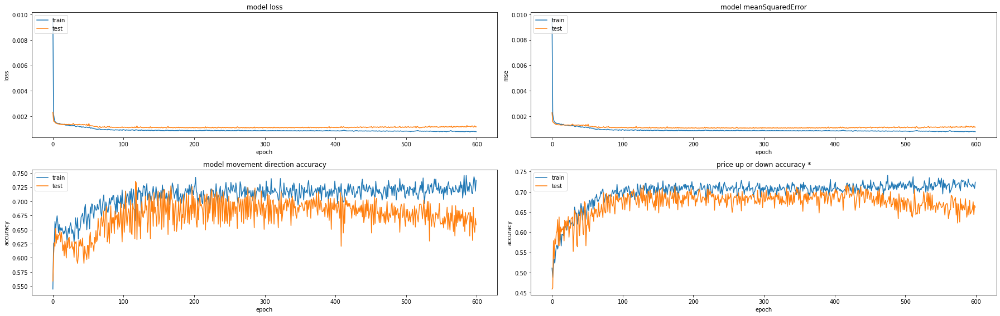

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6951 - above_or_below_zero_accuracy: 0.7175
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


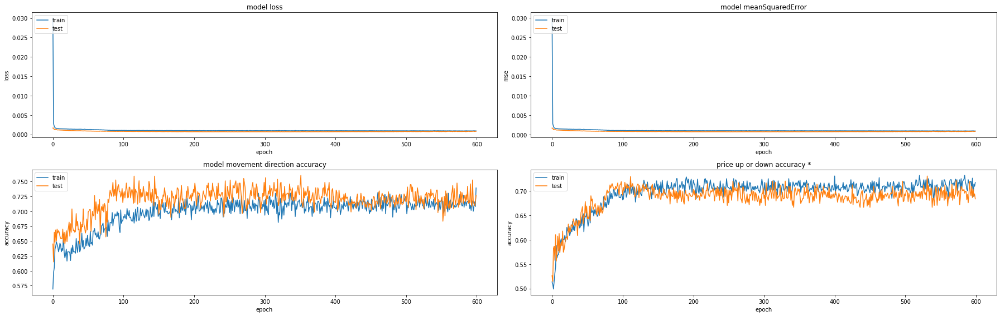

223/223 [==============================] - 1s 6ms/step - loss: 7.3340e-04 - mean_squared_error: 7.3340e-04 - movement_accuracy: 0.7265 - above_or_below_zero_accuracy: 0.7309
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


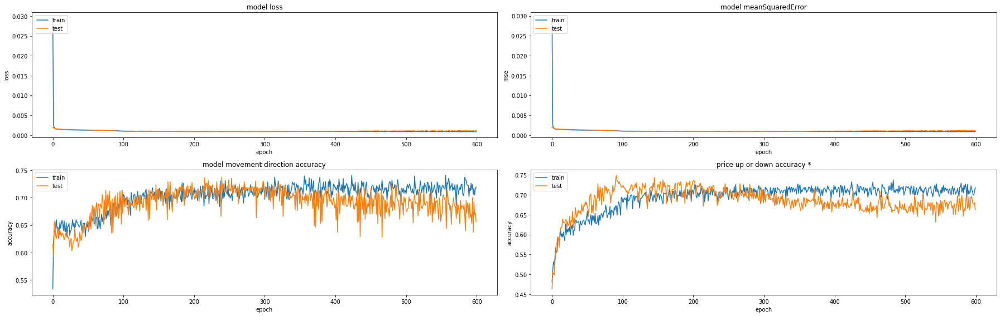

223/223 [==============================] - 1s 6ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.6816 - above_or_below_zero_accuracy: 0.7489

Results:

MeanSquaredError: [0.0010090485448017716, 0.001068448880687356, 0.0007913541048765182, 0.000918544945307076, 0.0008151387446559966, 0.0012952924007549882, 0.0007048225961625576, 0.001077814493328333, 0.0006649100105278194, 0.0008458956726826727]
MovementDiretionAccuracy: [0.6875, 0.7767857313156128, 0.7309417128562927, 0.7623318433761597, 0.7757847309112549, 0.7142857313156128, 0.7589285969734192, 0.7399103045463562, 0.7623318433761597, 0.7443946003913879]
AboveOrBellowAccuracy: [0.7723214030265808, 0.7410714030265808, 0.713004469871521, 0.7399103045463562, 0.7219731211662292, 0.7053571343421936, 0.8035714030265808, 0.7174887657165527, 0.7309417128562927, 0.7488788962364197]

MeanSquaredError mean: 0.000919127039378509
MovementDiretionAccuracy mean: 0.7453195095062256
AboveOrBellowAccuracy mean: 0.73945186138153

In [19]:
features = [variation, RSI_56]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


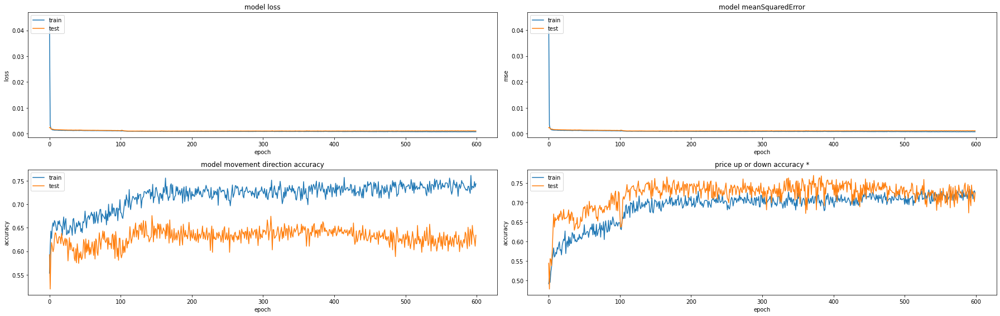

224/224 [==============================] - 1s 5ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.6607 - above_or_below_zero_accuracy: 0.7723
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


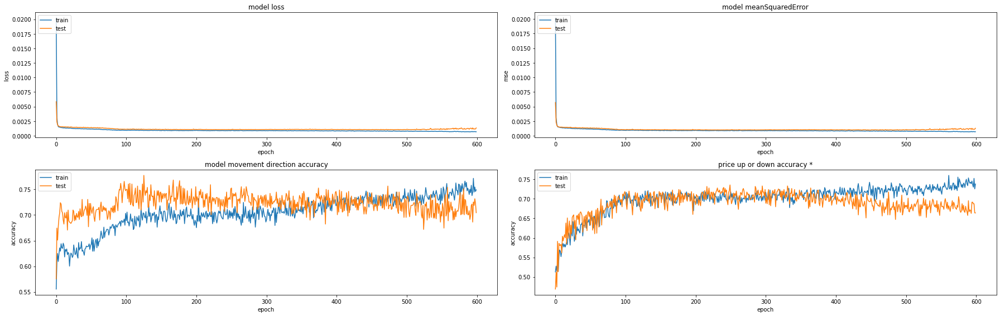

224/224 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7500 - above_or_below_zero_accuracy: 0.7411
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


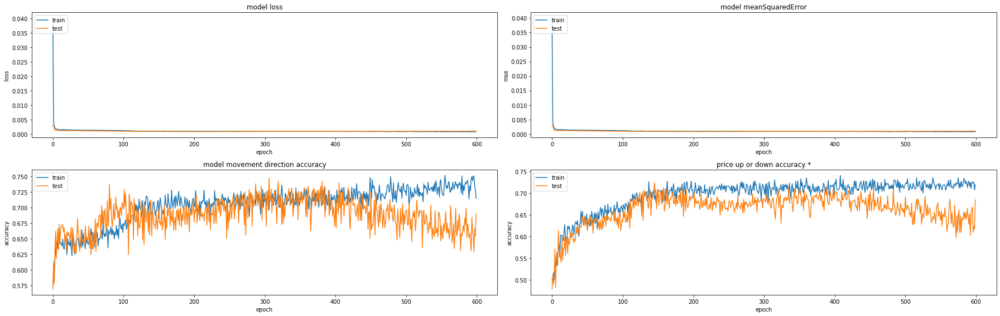

223/223 [==============================] - 1s 6ms/step - loss: 8.6601e-04 - mean_squared_error: 8.6601e-04 - movement_accuracy: 0.6682 - above_or_below_zero_accuracy: 0.7309
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


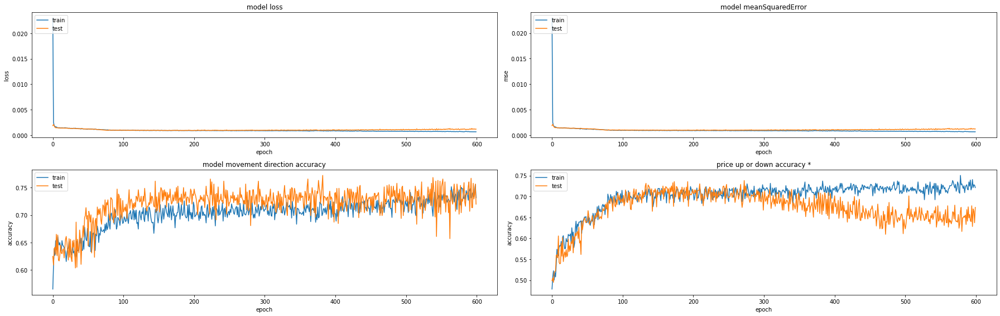

223/223 [==============================] - 1s 6ms/step - loss: 9.8508e-04 - mean_squared_error: 9.8508e-04 - movement_accuracy: 0.7130 - above_or_below_zero_accuracy: 0.7399
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


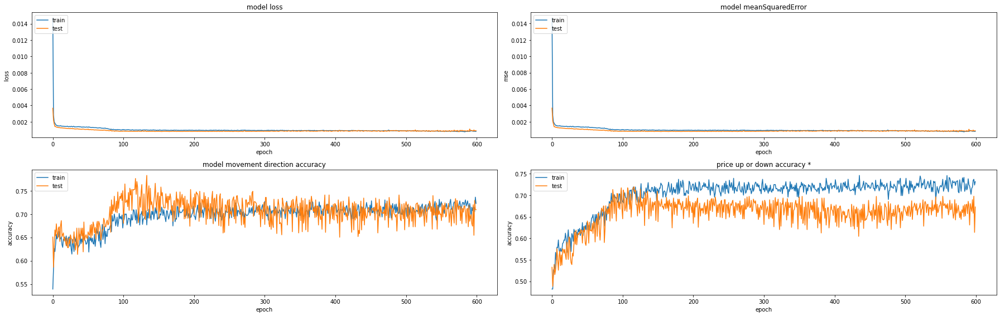

223/223 [==============================] - 1s 6ms/step - loss: 8.2451e-04 - mean_squared_error: 8.2451e-04 - movement_accuracy: 0.7534 - above_or_below_zero_accuracy: 0.7220
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


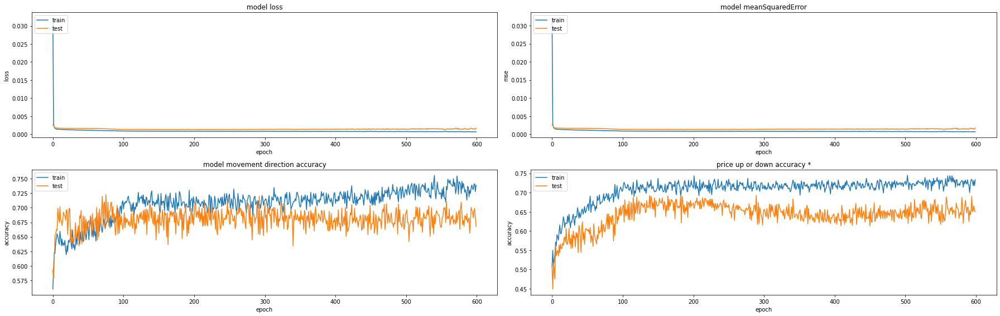

224/224 [==============================] - 1s 6ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - movement_accuracy: 0.7054 - above_or_below_zero_accuracy: 0.7009
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


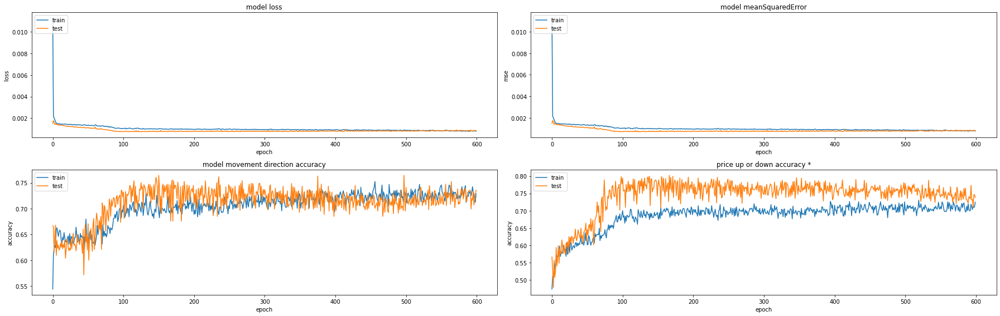

224/224 [==============================] - 1s 6ms/step - loss: 7.6578e-04 - mean_squared_error: 7.6578e-04 - movement_accuracy: 0.7366 - above_or_below_zero_accuracy: 0.7991
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


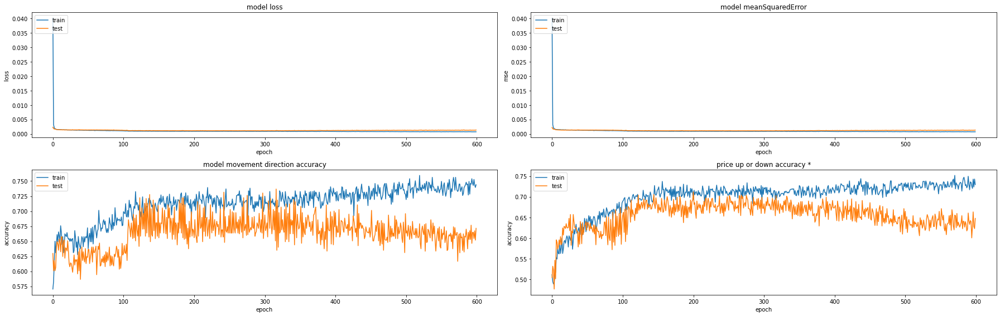

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6547 - above_or_below_zero_accuracy: 0.7175
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


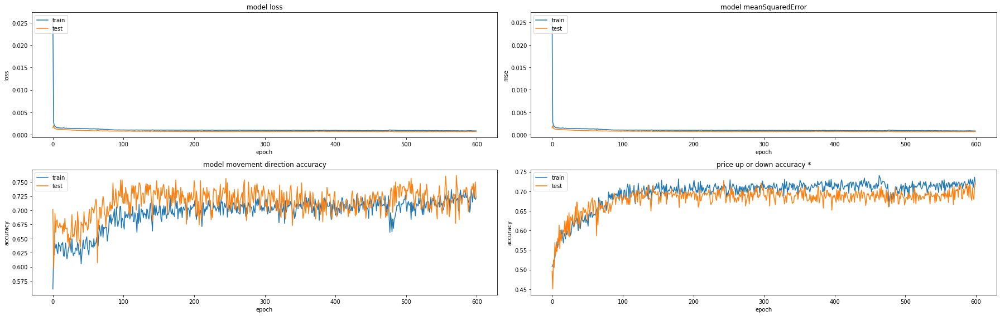

223/223 [==============================] - 1s 6ms/step - loss: 6.7815e-04 - mean_squared_error: 6.7815e-04 - movement_accuracy: 0.7309 - above_or_below_zero_accuracy: 0.7265
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


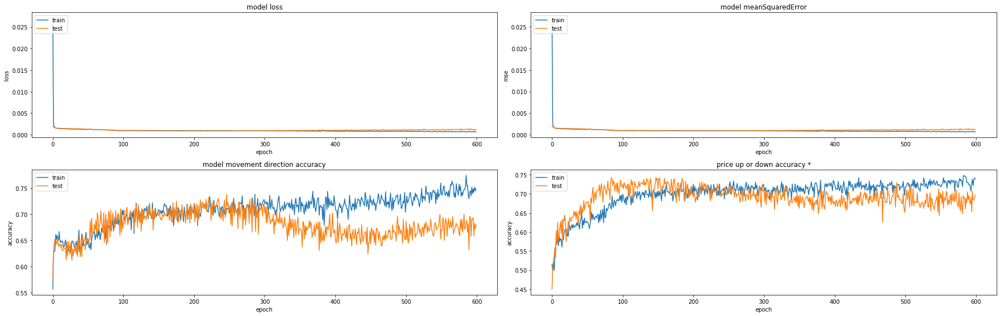

223/223 [==============================] - 1s 6ms/step - loss: 8.8721e-04 - mean_squared_error: 8.8721e-04 - movement_accuracy: 0.7085 - above_or_below_zero_accuracy: 0.7444

Results:

MeanSquaredError: [0.0010078097693622112, 0.0010207896120846272, 0.000812424928881228, 0.0009293182520195842, 0.0007705963798798621, 0.0012948402436450124, 0.000718127004802227, 0.001076766406185925, 0.0006302408874034882, 0.0008535442175343633]
MovementDiretionAccuracy: [0.6785714030265808, 0.7723214030265808, 0.7443946003913879, 0.7668161392211914, 0.7802690863609314, 0.7232142686843872, 0.7544642686843872, 0.7399103045463562, 0.7578475475311279, 0.7488788962364197]
AboveOrBellowAccuracy: [0.7723214030265808, 0.7410714030265808, 0.7309417128562927, 0.7399103045463562, 0.7219731211662292, 0.7008928656578064, 0.7991071343421936, 0.7174887657165527, 0.726457417011261, 0.7443946003913879]

MeanSquaredError mean: 0.0009114457701798528
MovementDiretionAccuracy mean: 0.746668791770935
AboveOrBellowAccuracy me

In [20]:
features = [variation, RSI_56, RSI_28]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


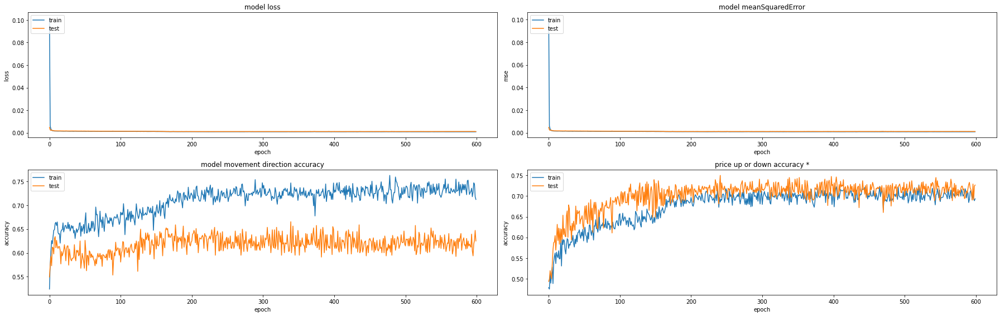

224/224 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6071 - above_or_below_zero_accuracy: 0.7500
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


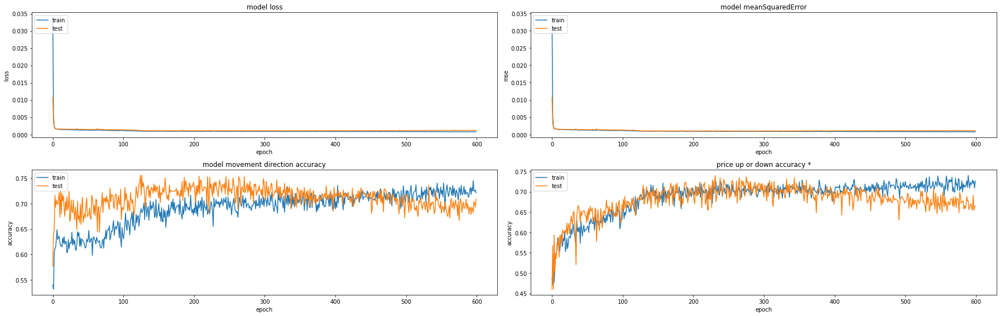

224/224 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7411 - above_or_below_zero_accuracy: 0.7455
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


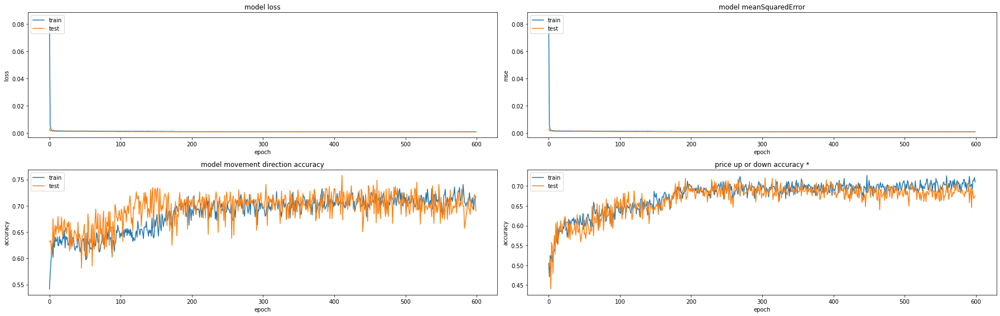

223/223 [==============================] - 1s 6ms/step - loss: 8.4070e-04 - mean_squared_error: 8.4070e-04 - movement_accuracy: 0.7399 - above_or_below_zero_accuracy: 0.7265
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


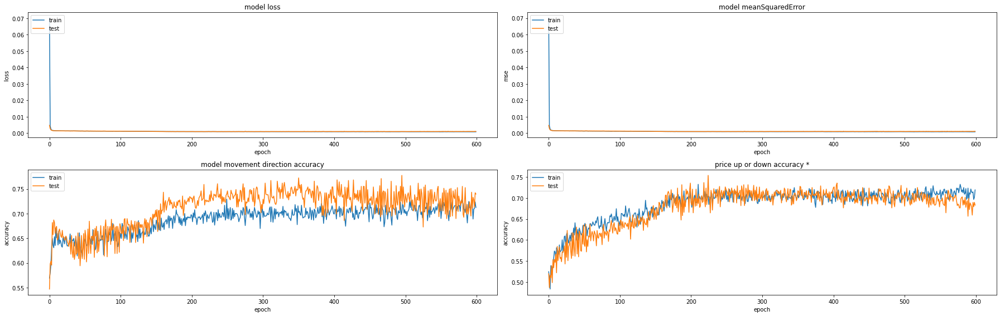

223/223 [==============================] - 1s 6ms/step - loss: 9.8688e-04 - mean_squared_error: 9.8688e-04 - movement_accuracy: 0.7220 - above_or_below_zero_accuracy: 0.7534
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


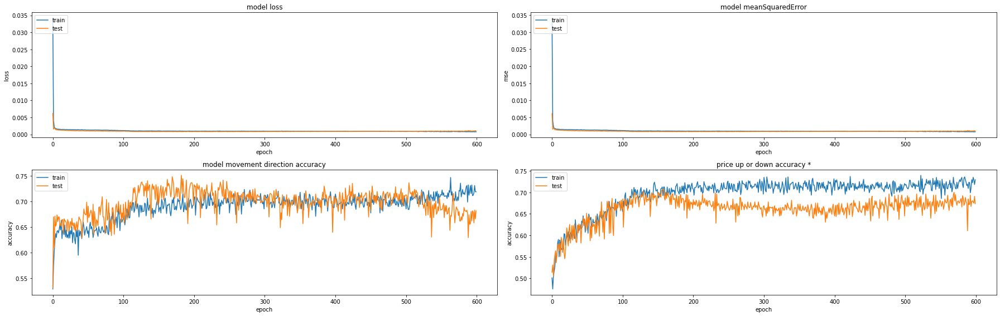

223/223 [==============================] - 1s 6ms/step - loss: 8.1898e-04 - mean_squared_error: 8.1898e-04 - movement_accuracy: 0.7309 - above_or_below_zero_accuracy: 0.7040
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


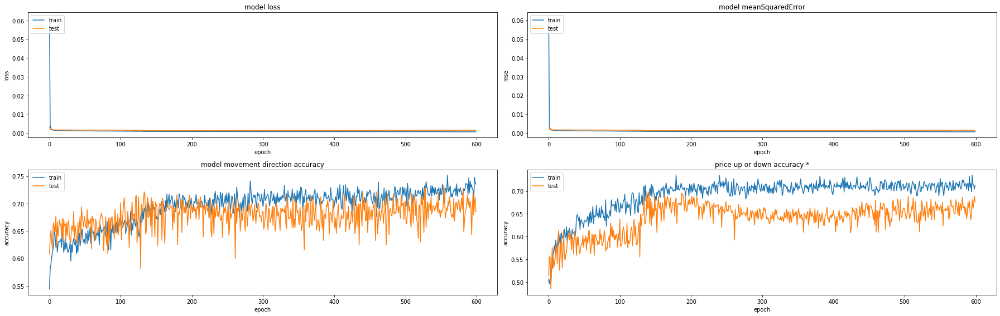

224/224 [==============================] - 1s 6ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - movement_accuracy: 0.7098 - above_or_below_zero_accuracy: 0.7054
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


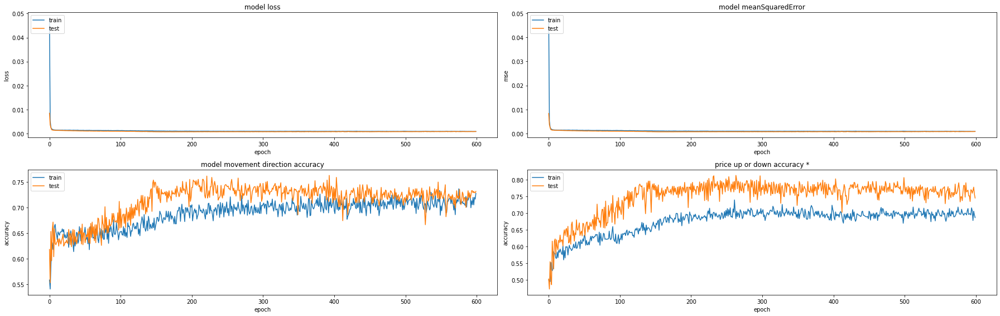

224/224 [==============================] - 1s 6ms/step - loss: 7.8759e-04 - mean_squared_error: 7.8759e-04 - movement_accuracy: 0.7232 - above_or_below_zero_accuracy: 0.8080
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


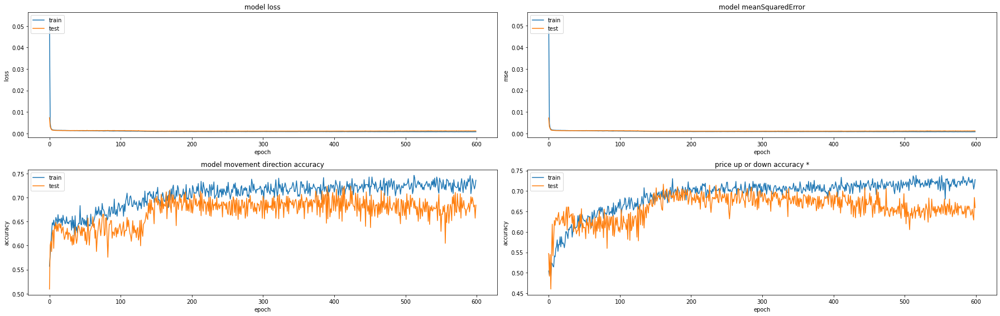

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6951 - above_or_below_zero_accuracy: 0.7265
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


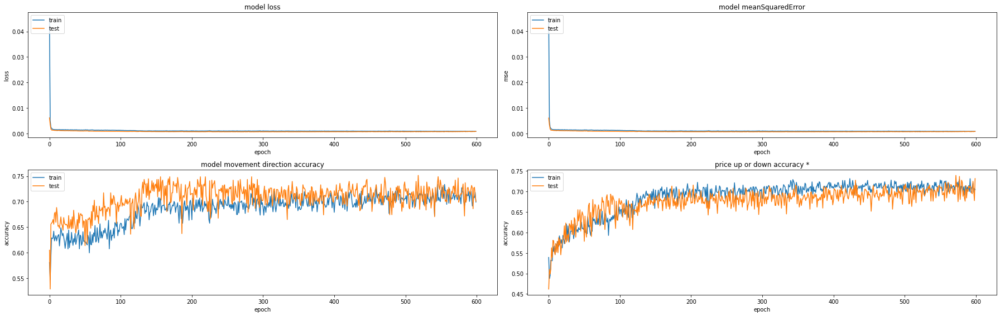

223/223 [==============================] - 1s 6ms/step - loss: 7.7684e-04 - mean_squared_error: 7.7684e-04 - movement_accuracy: 0.6996 - above_or_below_zero_accuracy: 0.7399
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


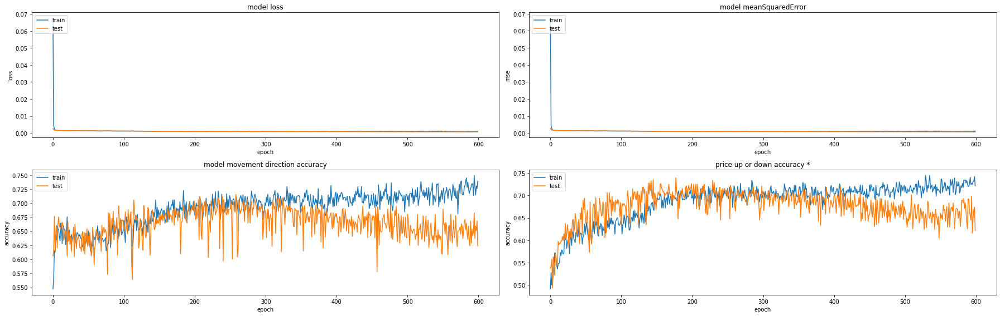

223/223 [==============================] - 1s 6ms/step - loss: 9.4620e-04 - mean_squared_error: 9.4620e-04 - movement_accuracy: 0.6951 - above_or_below_zero_accuracy: 0.7399

Results:

MeanSquaredError: [0.0010351896053180099, 0.0010483881924301386, 0.0008250798564404249, 0.0009324069251306355, 0.0008120714337565005, 0.001309255138039589, 0.0007178690866567194, 0.001083992887288332, 0.0006786463782191277, 0.0008985327440313995]
MovementDiretionAccuracy: [0.6651785969734192, 0.75, 0.7578475475311279, 0.7757847309112549, 0.7533632516860962, 0.7366071343421936, 0.7544642686843872, 0.726457417011261, 0.7488788962364197, 0.726457417011261]
AboveOrBellowAccuracy: [0.75, 0.7455357313156128, 0.726457417011261, 0.7533632516860962, 0.7040358781814575, 0.7053571343421936, 0.8080357313156128, 0.726457417011261, 0.7399103045463562, 0.7399103045463562]

MeanSquaredError mean: 0.0009341432247310877
MovementDiretionAccuracy mean: 0.739503926038742
AboveOrBellowAccuracy mean: 0.7399063169956207

MeanSq

In [21]:
features = [variation, RSI_56, STOCHk_56]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')